# Preprocessing and registration
This notebook does basic preprocessing and registration for lightsheet data

Here working on MORF 4x downsampled from harddrive.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib notebook
import os
from glob import glob
from os.path import join as pathjoin
import time

import imp
import donglab_workflows as dw
imp.reload(dw)


<module 'donglab_workflows' from '/home/dtward/Documents/UCLA/dong/donglab_workflows/donglab_workflows.py'>

In [2]:
# for now add emlddmm library for registration
import sys
sys.path.append('/home/dtward/data/csh_data/emlddmm')
import emlddmm
imp.reload(emlddmm)

<module 'emlddmm' from '/home/dtward/data/csh_data/emlddmm/emlddmm.py'>

In [3]:
# where should outputs go?
output_prefix = 'lightsheet_outputs_v03c/'

In [4]:
output_directory = os.path.split(output_prefix)[0]
if output_directory:
    if not os.path.exists(output_directory):
        os.mkdir(output_directory)

In [5]:
# load target image
target_name = 'SYTO16_488_086780_109130_down.npz'



In [6]:
target_data = np.load(target_name,allow_pickle=True)

In [7]:
J = target_data['I'][None]
J = J.astype(np.float32)
J /= np.mean(np.abs(J))
xJ = target_data['xI']
dJ = [x[1] - x[0] for x in xJ]
J0 = np.copy(J)

<IPython.core.display.Javascript object>


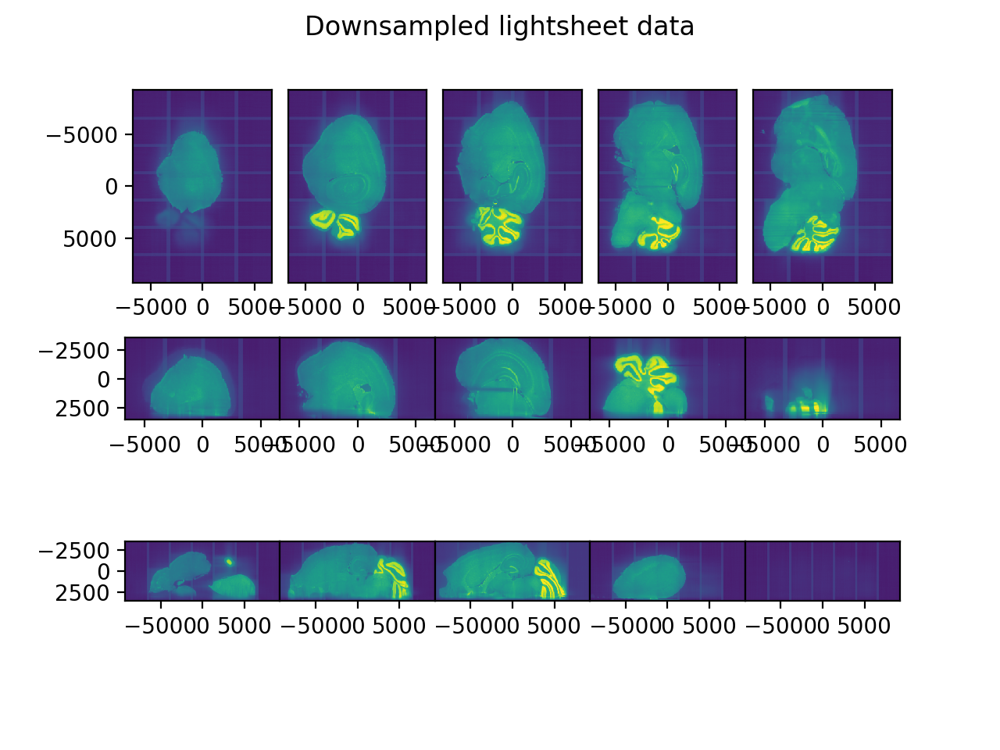

4294967296 4294967296


In [8]:
fig,ax = emlddmm.draw(J,xJ,vmin=np.min(J))
fig.suptitle('Downsampled lightsheet data')
figopts = {'dpi':300,'quality':90}
fig.savefig(output_prefix + 'downsampled.jpg',**figopts)

In [9]:
# load atlas images
atlas_names = [
    '/home/dtward/data/AllenInstitute/allen_vtk/ara_nissl_50.vtk',
    '/home/dtward/data/AllenInstitute/allen_vtk/average_template_50.vtk',
]
seg_name = '/home/dtward/data/AllenInstitute/allen_vtk/annotation_50.vtk'

In [10]:
I = []
for atlas_name in atlas_names:
    xI,I_,title,names = emlddmm.read_data(atlas_name)
    I_ = I_.astype(np.float32)
    I_ /= np.mean(np.abs(I_))
    I.append(I_)
    
I = np.concatenate(I)    
dI = [x[1] - x[0] for x in xI]
XI = np.meshgrid(*xI,indexing='ij')

<IPython.core.display.Javascript object>


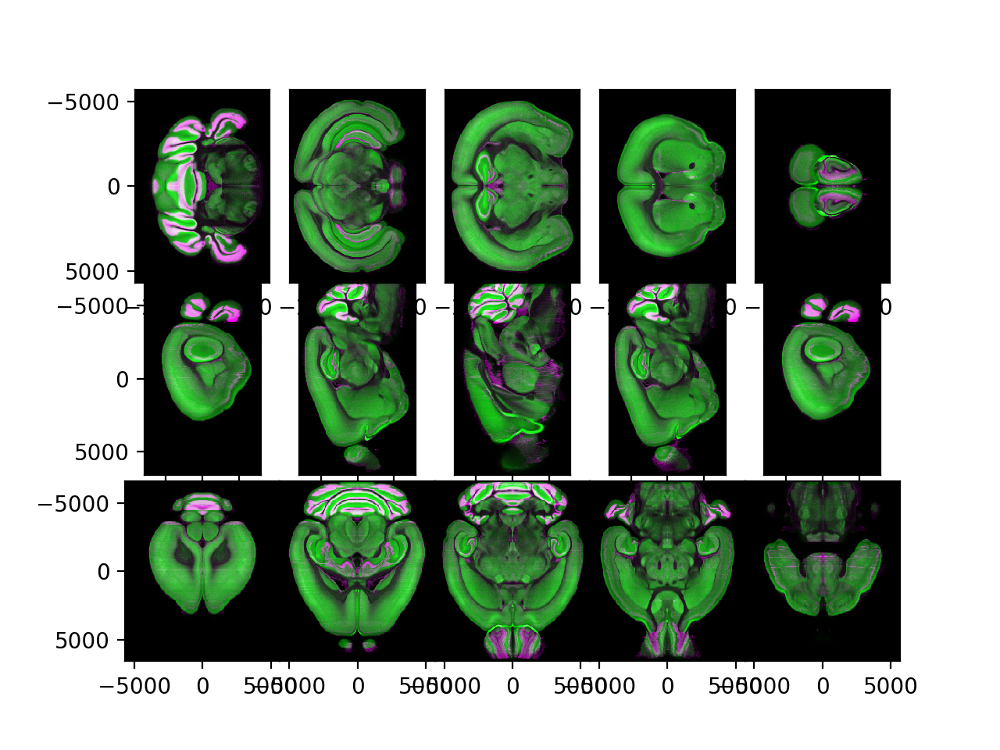

In [11]:
fig,ax = emlddmm.draw(I,xI,vmin=0)
fig.canvas.draw()

<IPython.core.display.Javascript object>


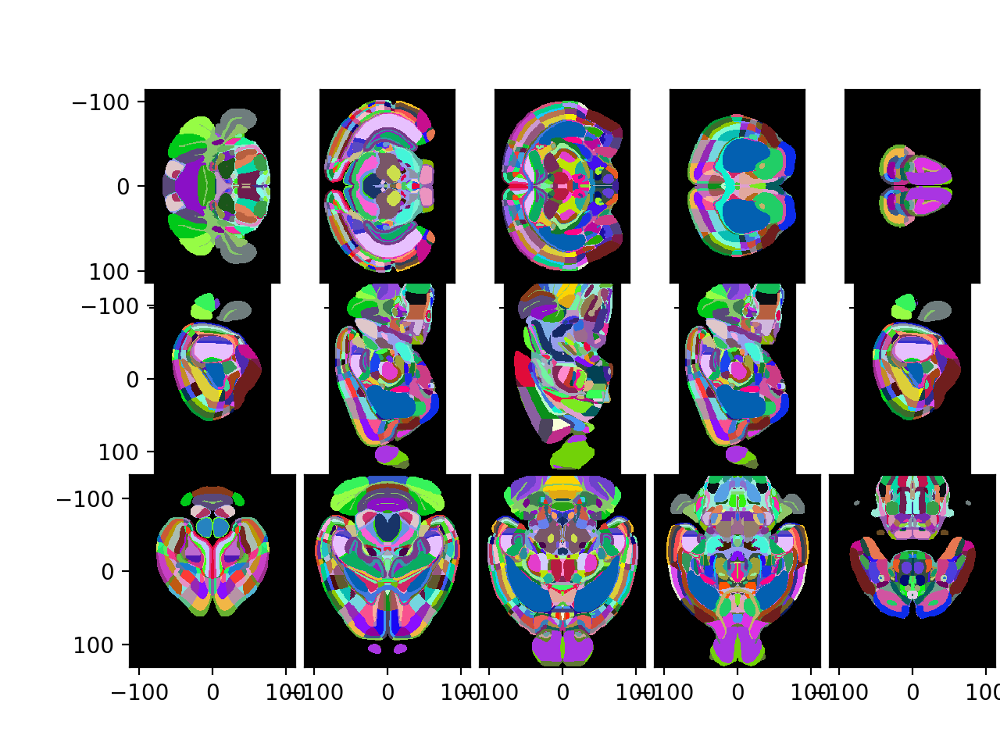

In [12]:
# next is to transforom the high resolution data
xS,S,title,names = emlddmm.read_data(seg_name)
# we want to visuze the above with S
labels = np.unique(S)
RGB = np.zeros((3,S.shape[1],S.shape[2],S.shape[3]))
colors = np.random.rand(len(labels),3)
colors[0] = 0.0
for i,l in enumerate(labels):
    RGB[:,S[0]==l] = colors[i][...,None]
fig,ax = emlddmm.draw(RGB)
plt.subplots_adjust(wspace=0,hspace=0,right=1)

<IPython.core.display.Javascript object>


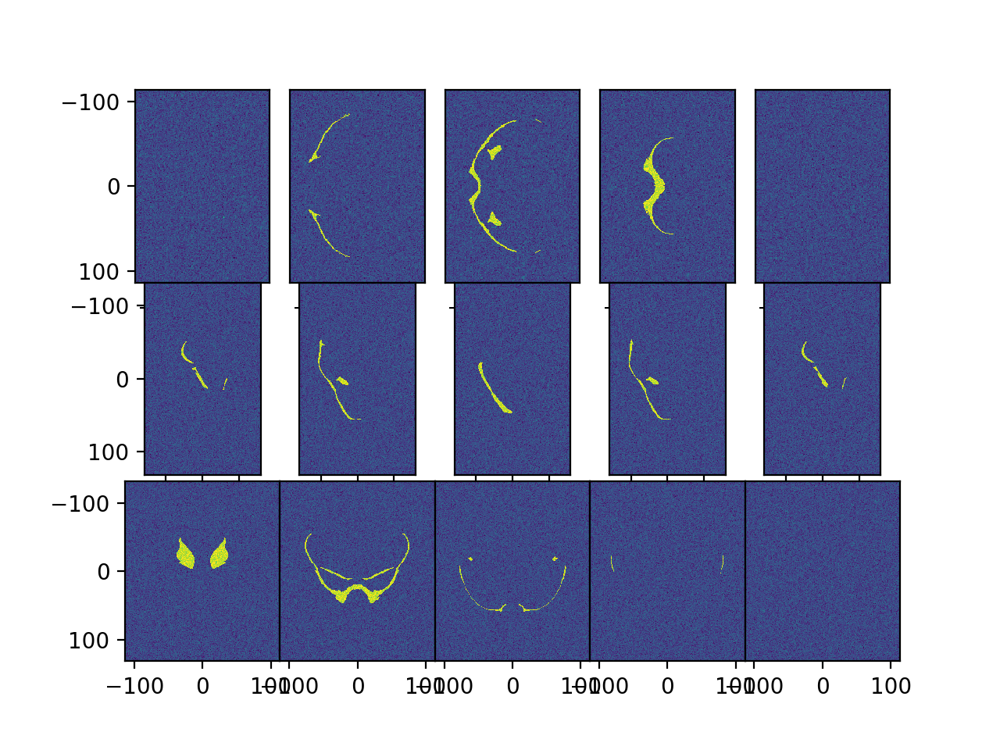

<IPython.core.display.Javascript object>


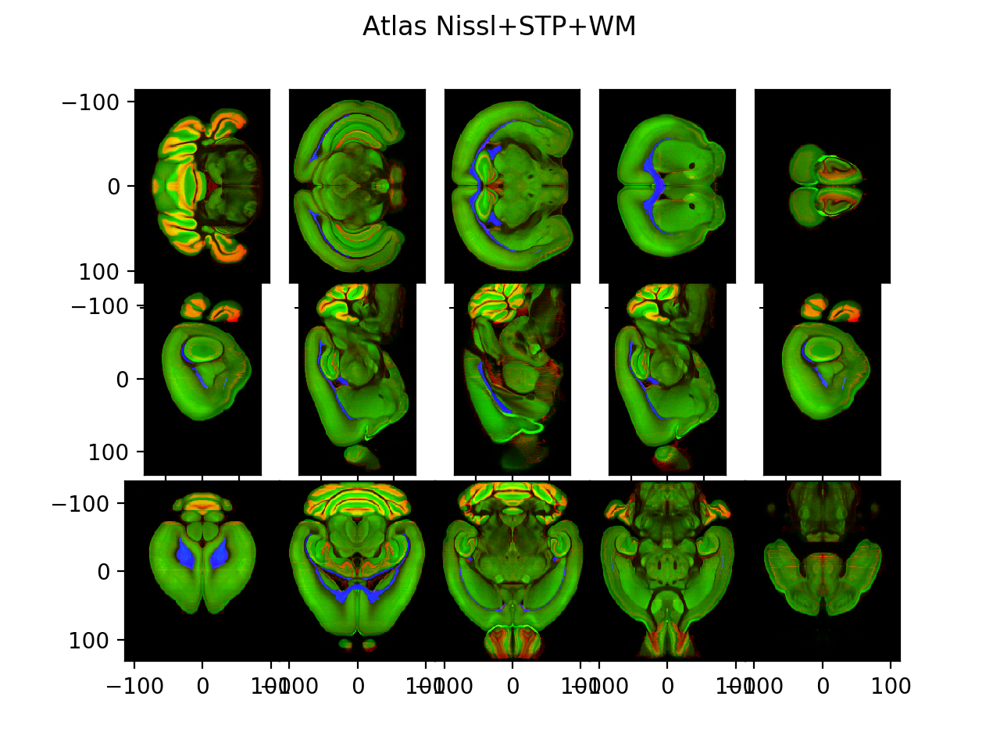

4294967296 4294967296


In [13]:
# I would like to add a channel to I that corresponds to corpus callosum
# see here: http://api.brain-map.org/api/v2/structure_graph_download/1.json
Icc = np.zeros_like(S)
Icc |= S==776 # corpus callosum
Icc |= S==956 # corpus callosum, anterior forceps
Icc |= S==964 # corpus callosum, extreme capsule
Icc |= S==1108 # genu of corpus callosum
Icc |= S==971 # corpus callosum, posterior forceps
Icc |= S==979 # corpus callosum, rostrum
Icc |= S==484682516 # corpus callosum, body
Icc |= S==986 # corpus callosum, splenium
# maybe add cingulum bundle, 940
Icc |= S==940
# maybe add fimbria, 603
Icc |= S==603
Icc = Icc.astype(I.dtype)
emlddmm.draw((Icc+np.random.randn(*Icc.shape)*0.1))
Icc /= np.mean(np.abs(Icc))
I = np.concatenate((I,Icc))
fig,ax = emlddmm.draw(I)
fig.suptitle('Atlas Nissl+STP+WM')
fig.savefig(output_prefix + 'atlasRGB.jpg',**figopts)



# Initial preprocessing



## Target preprocessing

0


<IPython.core.display.Javascript object>


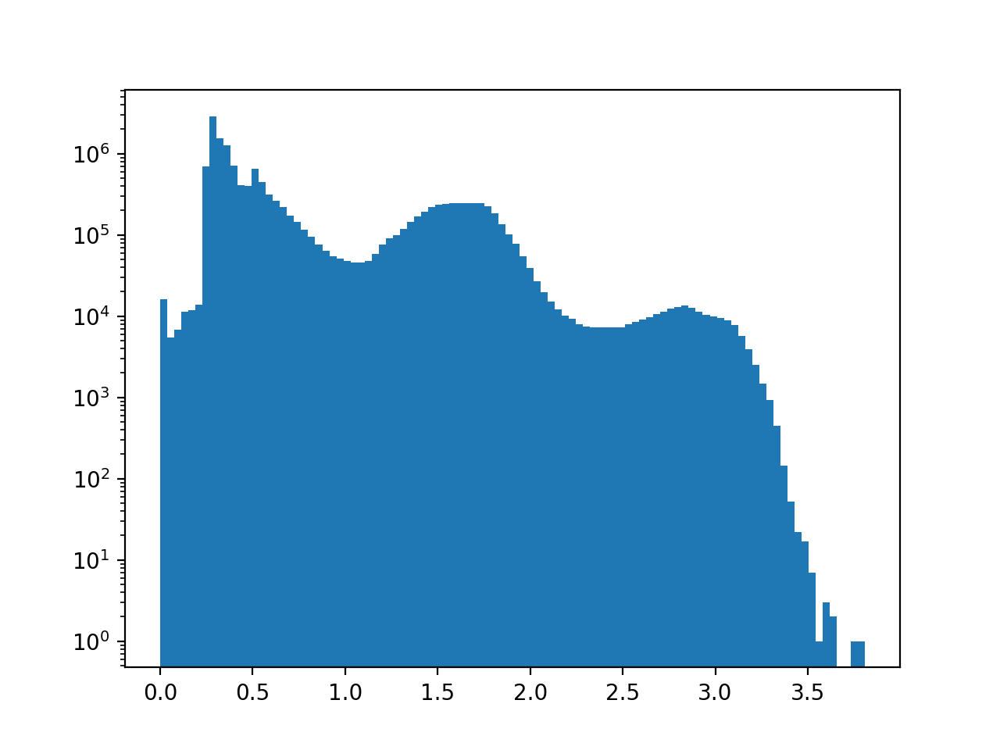

<IPython.core.display.Javascript object>


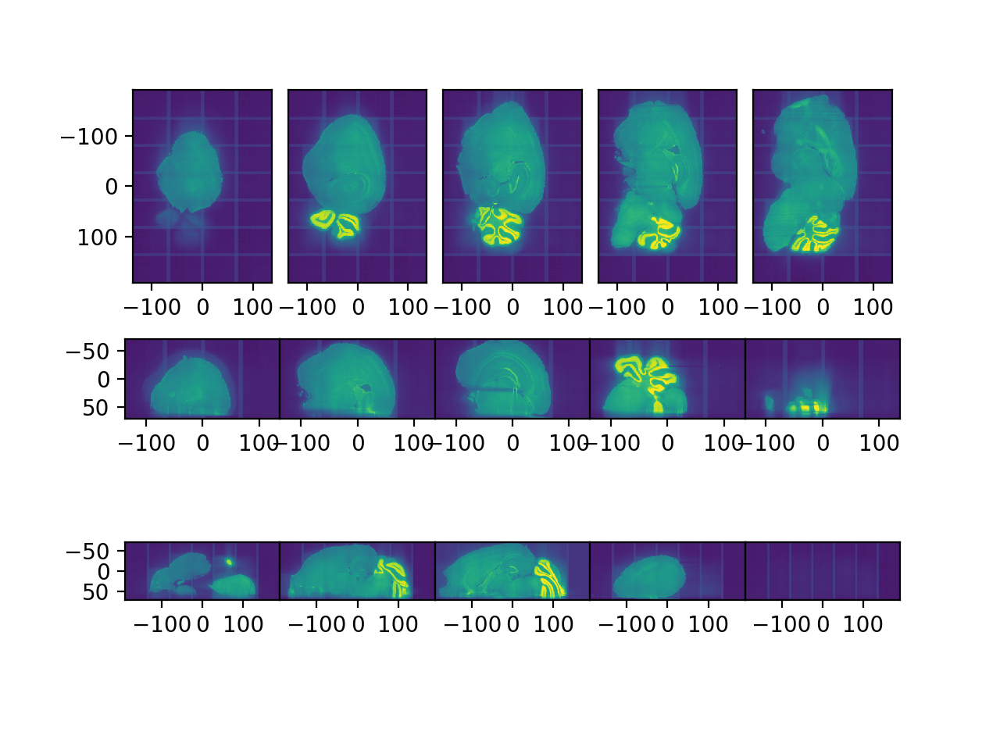

(<Figure size 640x480 with 15 Axes>,
 [[<matplotlib.axes._subplots.AxesSubplot at 0x7fd210e087d0>,
   <matplotlib.axes._subplots.AxesSubplot at 0x7fd215728b10>]])

In [14]:
J = np.copy(J0)
print(np.sum(J==0))
# adjust zero pixels
q = 0.00
Jq = np.quantile(J,q)
J[J<=Jq] = Jq
J -= np.min(J)
f,ax = plt.subplots()
ax.hist((J**1).ravel(),100,log=True)
emlddmm.draw(J)

<IPython.core.display.Javascript object>


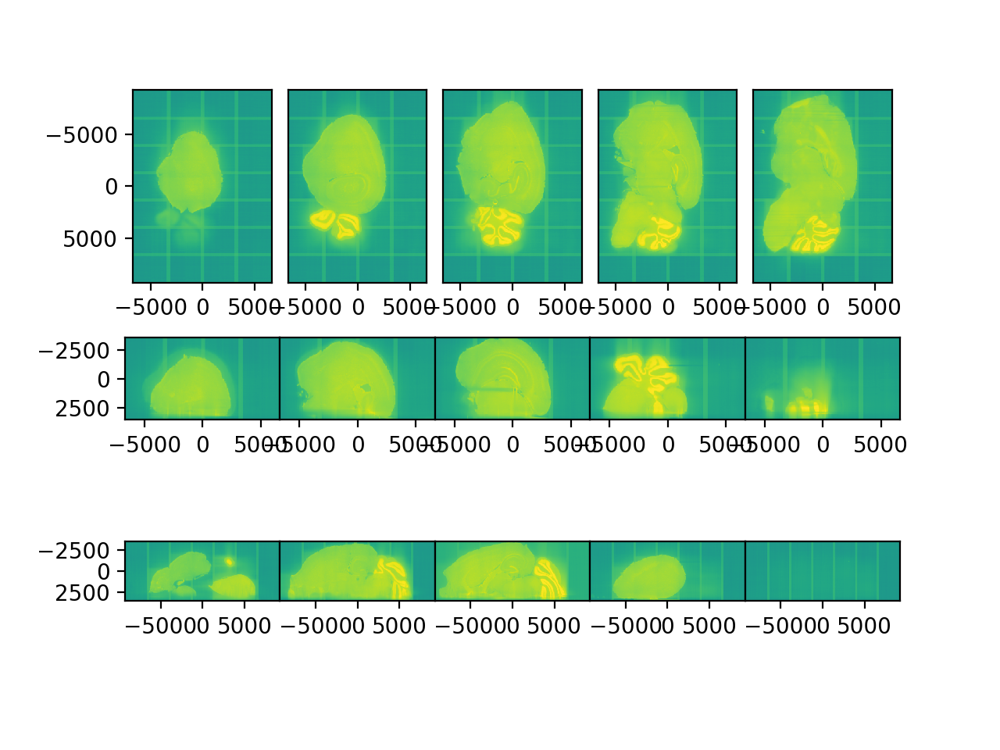

<IPython.core.display.Javascript object>


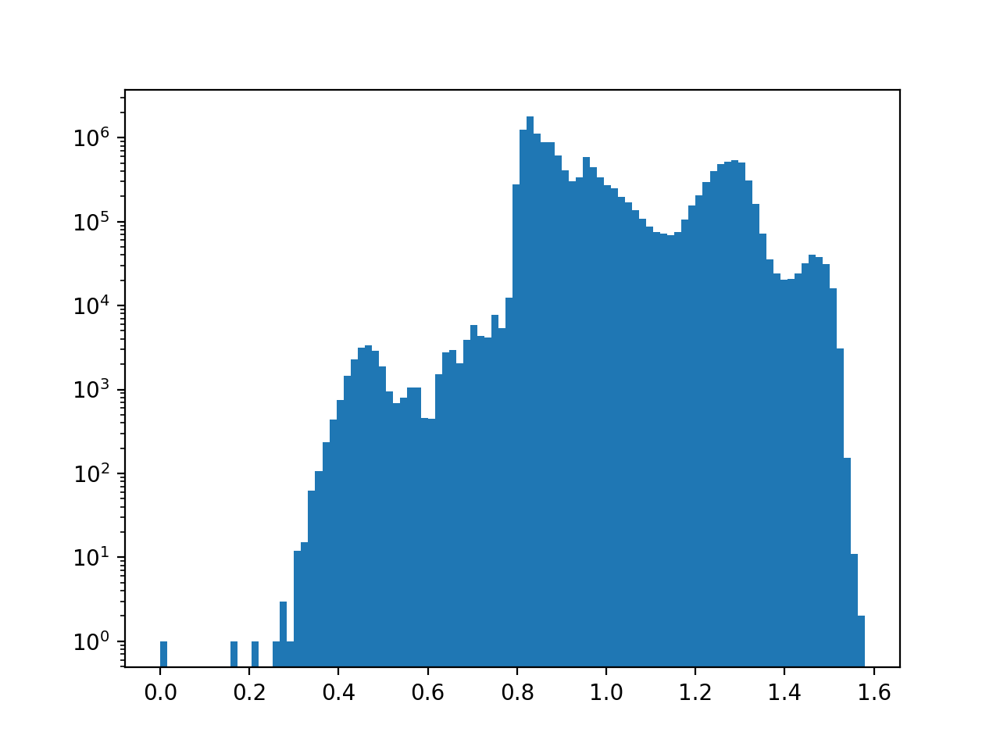

In [15]:
# adjust dynamic range
J = J**0.25
# adjust mean value
J /= np.mean(np.abs(J))
fig,ax = emlddmm.draw(J,xJ,vmin=0)
fig.canvas.draw()
fig,ax = plt.subplots()
ax.hist(J.ravel(),100,log=True)
fig.canvas.draw()

<IPython.core.display.Javascript object>


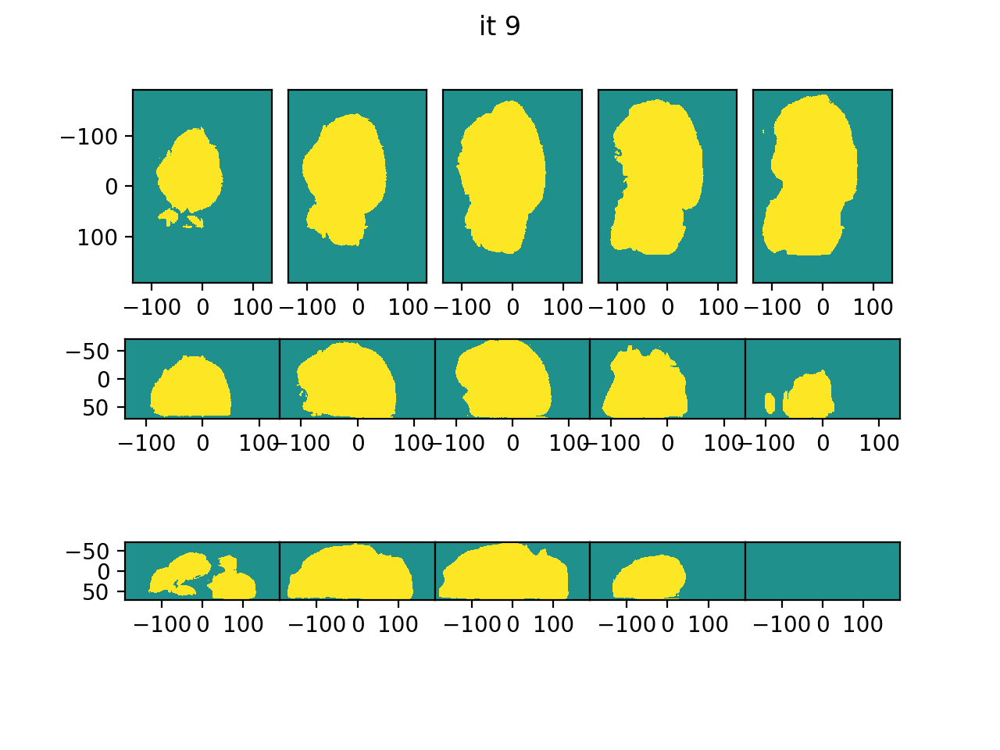

In [16]:
# let's detect background, we'll cluster into 3 class with kmeans
fig = plt.figure()
niter = 10
mu = np.array([0.,np.quantile(J,0.9),np.quantile(J,0.999)])
clold = np.zeros(J.shape[1:])
for it in range(niter):
    d2 = (J - mu[...,None,None,None])**2
    # assign
    cl = np.argmin(d2,axis=0)
    # update
    for i in range(len(mu)):
        mu[i] = np.mean(J[cl[None]==i])
    emlddmm.draw(cl[None],fig=fig)
    fig.suptitle(f'it {it}')
    fig.canvas.draw()
    if np.all(cl==clold):
        break
    clold = cl

<IPython.core.display.Javascript object>


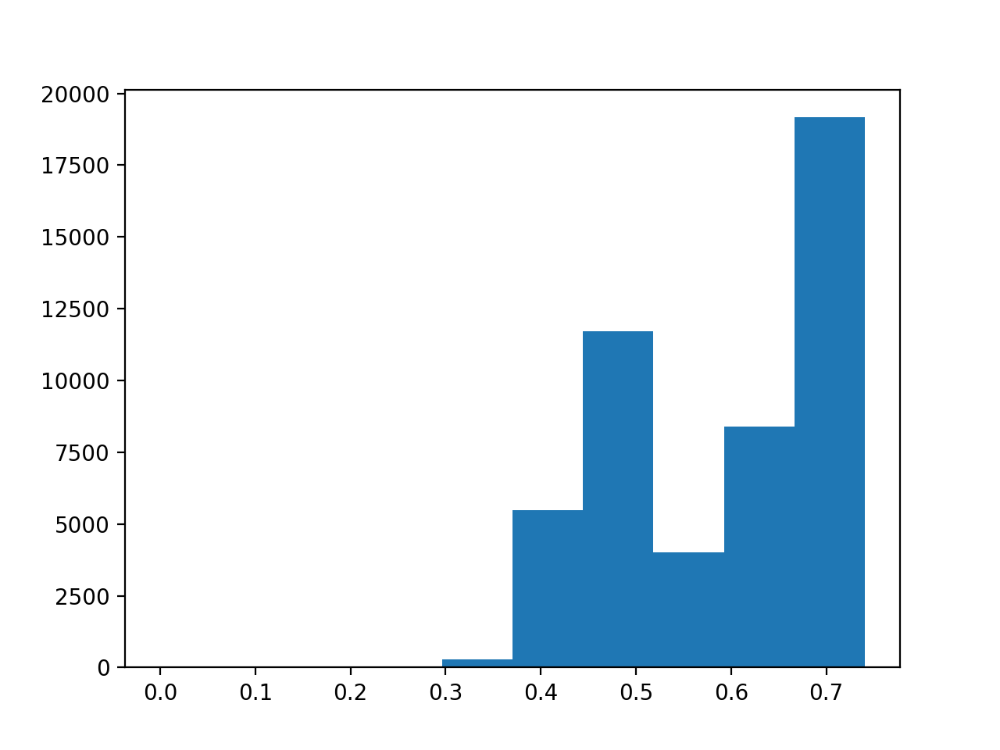

(array([1.0000e+00, 0.0000e+00, 2.0000e+00, 5.0000e+00, 2.8500e+02,
        5.4690e+03, 1.1708e+04, 4.0190e+03, 8.3920e+03, 1.9163e+04]),
 array([0.        , 0.0740508 , 0.1481016 , 0.22215238, 0.2962032 ,
        0.37025398, 0.44430476, 0.51835555, 0.5924064 , 0.6664572 ,
        0.74050796], dtype=float32),
 <a list of 10 Patch objects>)

In [17]:
# look at background hist
f,ax = plt.subplots()
ax.hist(J[cl[None]==0])

In [18]:
# we want a softmax with an elbow at the background max
# anything less than this will quickly go to zero
cut = np.max(J[cl[None]==0])
cutstd = np.std(J[cl[None]==0])
cut,cutstd

(0.74050796, 0.11343612)

<IPython.core.display.Javascript object>


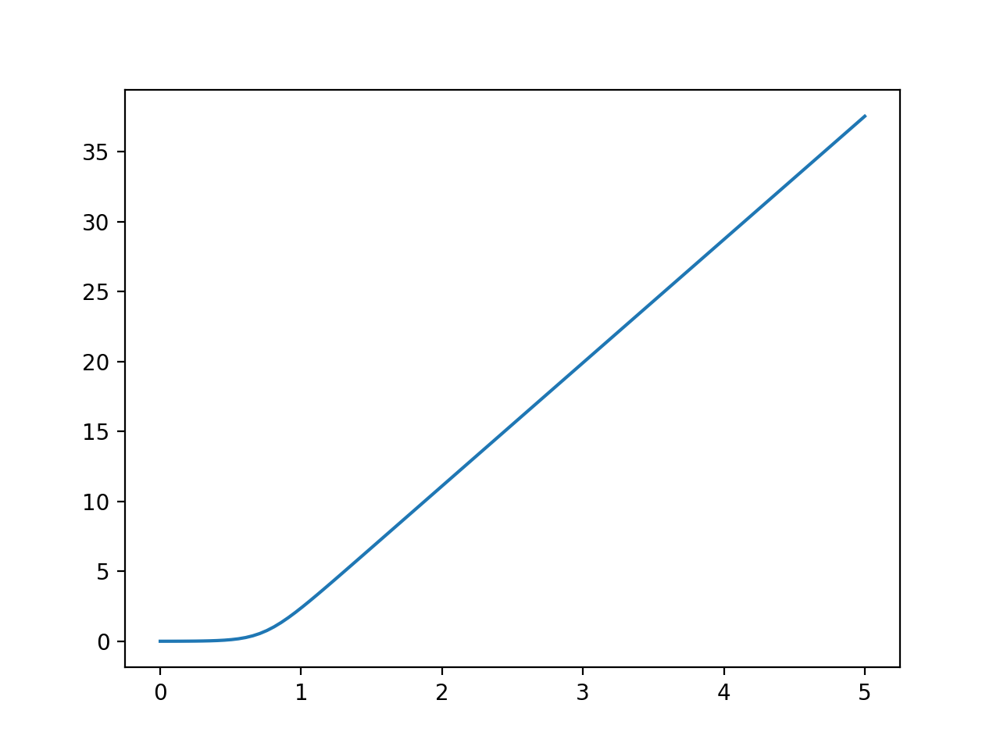

In [19]:
t = np.linspace(0.0,5.0,100)
f,ax = plt.subplots()
ax.plot(t,np.log(1.0 + np.exp((t-cut)/cutstd)))
# how to encode the elbow

<IPython.core.display.Javascript object>


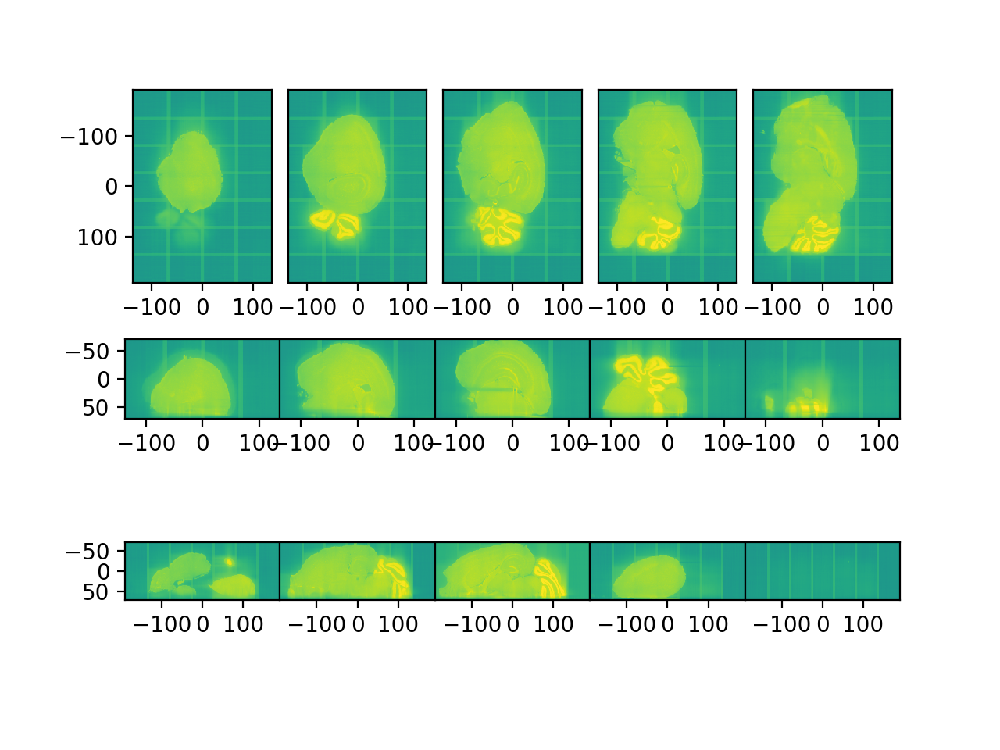

<IPython.core.display.Javascript object>


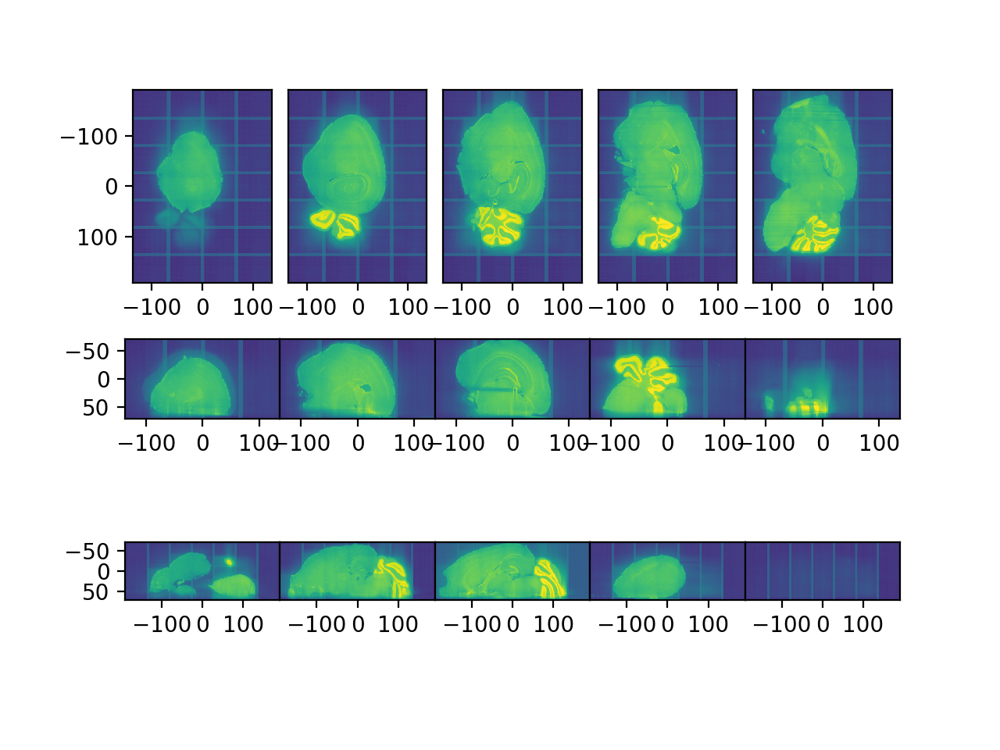

In [20]:
# now we want to suppress the background
# I'll use a softplus
#beta = 1.0/np.mean(J[cl[None]==0])
#J_ = np.log(1.0 + np.exp((J - 1.0/beta)*beta))/beta
#p = 3
#J_ = (1.0 + (J*beta)**p)**(1/p)/beta - 1.0
J_ = np.log(1.0 + np.exp((J-cut)/np.std(J[cl[None]==0])))

t = np.linspace(0.0,5.0,100)
#f,ax = plt.subplots()
#ax.plot(t,np.log(1.0 + np.exp((t - 1.0/beta)*beta))/beta)
emlddmm.draw(J,vmin=0)
emlddmm.draw(J_,vmin=0)
J = J_/np.mean(np.abs(J_))


<IPython.core.display.Javascript object>


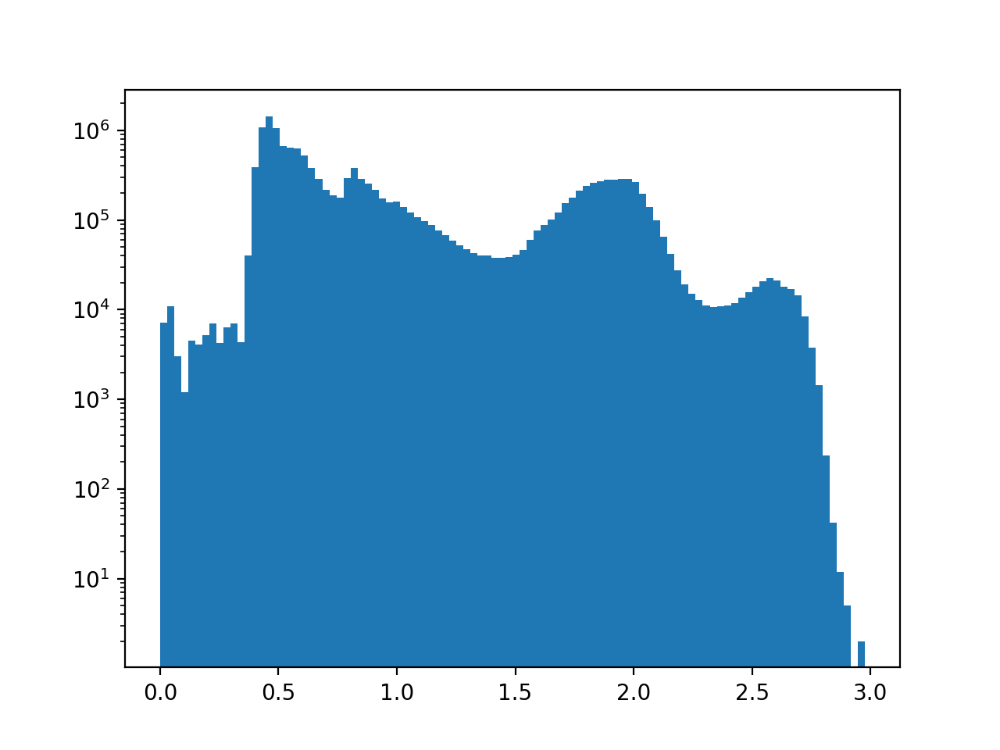

<IPython.core.display.Javascript object>


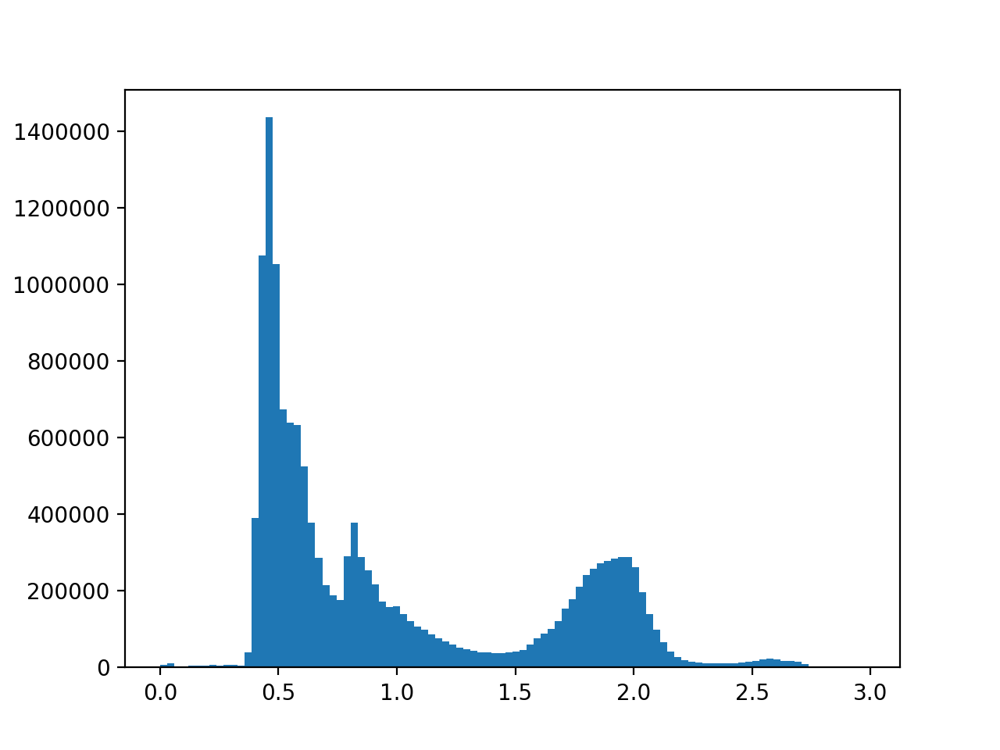

In [21]:
fig,ax = plt.subplots()
ax.hist(J.ravel(),100,log=True)
fig.canvas.draw()

fig,ax = plt.subplots()
ax.hist(J.ravel(),100,log=False)
fig.canvas.draw()

In [22]:
# i would like to minimize entropy but keep the same first and second moment
# that is the ideal
# that would require some kind of constrained optimization

# Inhomogeneity

We look for a smooth $v$ to minimize the entropy
\begin{align}
H &= -\sum_i p_i \log(p_i)
\end{align}

Where 
\begin{align}
p_i &=\frac{ \sum_j k( I_j\exp(v) - b_i) }{ \sum_{i'} \sum_j k(I_j\exp(v) - b_{i'})}
\end{align}

And $k$ is a Gaussian
\begin{align}
k(x) &= \exp(-x^2)
\end{align}


Work out the derivative of $H$ with respect to $p$
\begin{align}
&\frac{d}{d\epsilon} -\sum_i (p_i + \epsilon \delta p_i) \log(p_i + \epsilon \delta p_i)\big|_{\epsilon = 0}\\
&= -\sum_i \delta p_i \log(p_i) + p_i \frac{1}{p_i} \delta p_i\\
&= -\sum_i (\log(p_i) + 1) \delta p_i
\end{align}

So the derivative is
\begin{align}
dH &= - \log(p_i) - 1
\end{align}
for $N$ classes

Now let $x = I\exp(v)$, and we'll work out the derivative of $p$
\begin{align}
&\frac{d}{d\epsilon} \frac{\sum_j k(x_j + \epsilon \delta x_j - b_i)}{\sum_{i'} \sum_{j}k(x_j + \epsilon \delta x_j - b_{i'})}\bigg|_{\epsilon = 0}\\
&= \frac{\sum_j \left(k'(x_j - b_i)\delta x_j\right)\left(\sum_{i'} \sum_{j}k(x_j  - b_{i'})\right) - \left(\sum_j k(x_j - b_i)\right)\left(\sum_{i'}\sum_j k'(x_j - b_{i'})\delta x_j\right)}{\sum_{i'}\sum_j k(x_{j} - b_{i'})}
\end{align}
So we have
\begin{align}
dp_i &= \frac{k'(x_j - b_i)\left(\sum_{i'} \sum_{j}k(x_j  - b_{i'})\right) - \sum_j k(x_j - b_i)\sum_i k'(x_j - b_i)}{\sum_{i'}\sum_j k(x_{j} - b_{i'})}
\end{align}
And if $\sum_i k(x - b_i) = K$ (a constant, i.e. if this sum approaches an integral over a gaussian), and then $\sum_i k'(x - b_i) = 0$ we have a simplification
\begin{align}
dp_i &= \frac{k'(x_j - b_i)MK -0}{MK} = k'(x_j - b_i)
\end{align}
if there are $M$ pixels and $N$ bins.

And last we have $dx = I \exp(v) $

Putting it all together we get a gradient
\begin{align}
\sum_i \left(- \log(p_i) - 1\right) k'( I_j \exp(v_j) - b_i)I_j \exp(v_j)
\end{align}
Note that this is nice and simple, whatever $K$ is.

The important thing here is that we can do a running sum over $i$.

In [23]:
Jsave = np.copy(J)

/home/dtward/.local/intelpython3/lib/python3.7/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


<IPython.core.display.Javascript object>


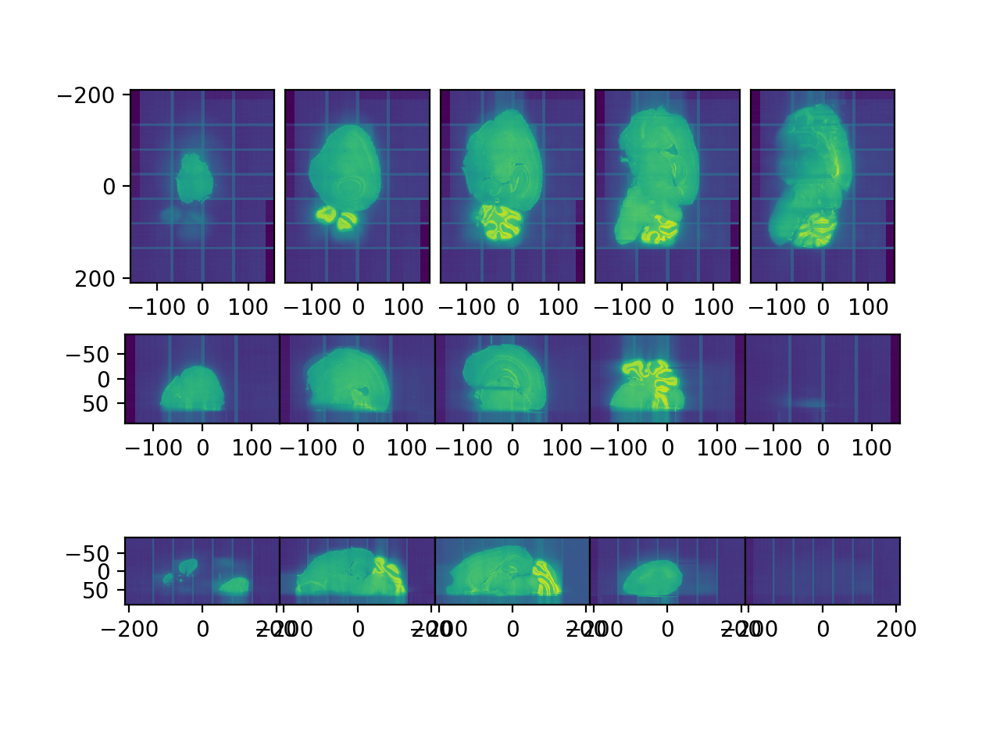

<IPython.core.display.Javascript object>


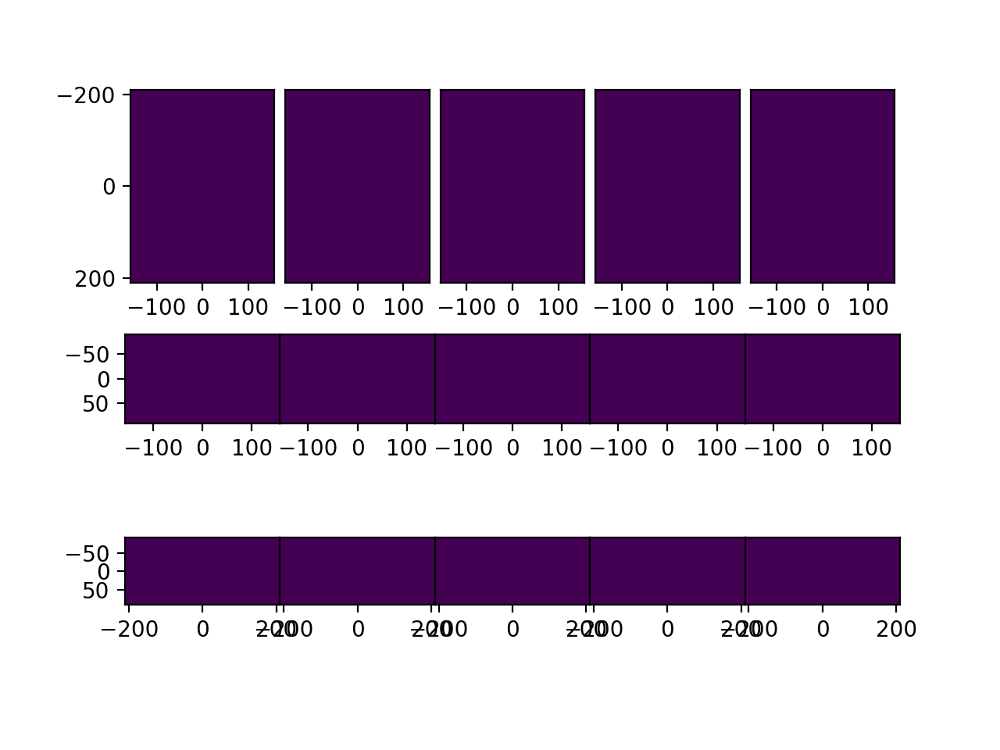

<IPython.core.display.Javascript object>


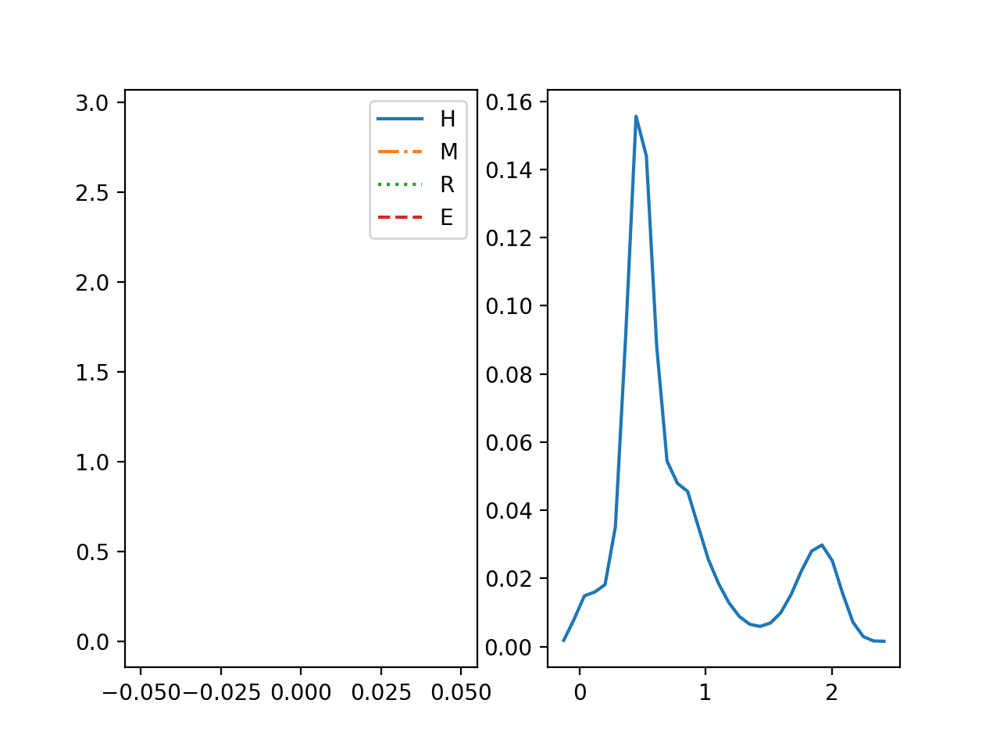

In [24]:
# note this needs to be updated! Normalization is not correct so the gradient and cost don't match
J = np.copy(Jsave)

import torch
# I need to double check that the signs are correct here
npad = 20
Jp = np.pad(J,((0,0),(npad,npad),(npad,npad),(npad,npad)), mode='edge')
device = 'cuda:0'
I0t = torch.as_tensor(Jp[0],device=device) # one channel

# get entropy with kernel density estimate

sigmaR = 1e0 # reg
per_pixel = True # if false, use mean and variance
sigmaM = 1e0 # match, 1e4 was good for per pixel

a = 20.0 # smoothing
p = 2.0
max_ = np.quantile(J,0.99)
#max_ = np.max(J)
min_ = 0.0 - max_*0.05
step = (max_-min_)/32
width = step # gaussian
bins = torch.arange(min_,max_,step,device=device)
ep = 5e-5



niter = 50
f = [torch.arange(n,device=device)/n for n in I0t.shape]
F = torch.stack(torch.meshgrid(f))
L = (1.0 + 2.0*a**2*torch.sum((1.0 - torch.cos(2.0*np.pi*F)),0))**p
K = 1.0/L**2

fig = plt.figure()
fig2 = plt.figure()
fig3,ax3 = plt.subplots(1,2)

# don't bias correct
ep = 0
niter = 1

v = torch.zeros_like(I0t)
Esave = []
for it in range(niter):
    # get density estimate
    I0tv = I0t*torch.exp(v) 
    #print(torch.std(I0tv[npad:-npad,npad:-npad,npad:-npad]).item())
    
    # we'll loop over i
    H = 0.0
    dH = torch.zeros_like(v)
    pmf = torch.zeros(len(bins))
    for i in range(len(bins)):
        p_i = torch.sum(torch.exp(-(I0tv - bins[i])**2/(2.0*width**2)))/np.sqrt(2.0*np.pi*width**2)
        pmf[i] = p_i
    pmf[torch.isnan(pmf)] = 0.0
    pmf /= torch.sum(pmf)
    for i in range(len(bins)):
        p_i = pmf[i]
        logpi = torch.log(p_i)
        H += -(p_i * logpi)
        dH += (-logpi - 1.0)*p_i * (I0tv - bins[i])
    dH *= I0tv/np.sqrt(2.0*np.pi*width**2)/width**2
    
    
    # we need to stay close to original data
    if per_pixel:
        M = torch.sum((I0tv - I0t)**2)/2.0/sigmaM**2
    else:
        M = (torch.mean(I0tv) - torch.mean(I0t))**2/2.0/sigmaM**2 +  (torch.std(I0tv) - torch.std(I0t))**2/2.0/sigmaM**2
    # we need reg for this we need a highpass
    R = torch.sum(torch.abs(torch.fft.fftn(v))**2*L**2)/torch.numel(v)/2.0/sigmaR**2
    E = H + M + R    
    Esave.append([(H).item(),M.item(),R.item(),E.item()])
    
    grad = dH + (I0tv - I0t)/sigmaM**2
    grad = torch.fft.ifftn(torch.fft.fftn(grad)*K).real + v/sigmaR**2
    v -= ep*grad
    
    # can we do something to make sure it has the same mean? or better yet the same std
    #Ivm = torch.mean((I0t*torch.exp(v))[:,npad:-npad,npad:-npad,npad:-npad])
    #v += torch.log(torch.mean(I0t[:,npad:-npad,npad:-npad,npad:-npad])/Ivm)
    
    # We want std(I0 exp(v+k)) = std(I0)
    # solve for k
    # std(I0 exp(v+k)) = std(I0 exp(v) exp(k)) = exp(k) std(I0exp(v))
    # so exp(k) = std(I0) / std(I0exp(v))
    # so k = log(std(I0) / std(I0exp(v)))
    Ivs = torch.std((I0t*torch.exp(v))[npad:-npad,npad:-npad,npad:-npad])
    v += torch.log(torch.std(I0t[npad:-npad,npad:-npad,npad:-npad])/Ivs)
    
    if not it%10 or it == niter-1:
        with torch.no_grad():
            emlddmm.draw(I0tv.cpu()[None],fig=fig,
                         vmin=torch.min(I0tv[npad:-npad,npad:-npad,npad:-npad]).cpu().item(),
                         vmax=torch.max(I0tv[npad:-npad,npad:-npad,npad:-npad]).cpu().item())
            emlddmm.draw(v[None].cpu(),fig=fig2,
                         vmin=None,#np.log(1/1.5),
                         vmax=None,#np.log(1.5)
                        )
            ax3[0].cla()
            #ax3[0].plot(Esave)
            ax3[0].plot(np.array(Esave)[:,0],ls='-')
            ax3[0].plot(np.array(Esave)[:,1],ls='-.')
            ax3[0].plot(np.array(Esave)[:,2],ls=':')
            ax3[0].plot(np.array(Esave)[:,3],ls='--')
            ax3[0].legend(['H','M','R','E'])
            ax3[1].cla()
            ax3[1].plot(bins.cpu().numpy(),pmf.detach().clone().cpu().numpy())
            fig.canvas.draw()
            fig2.canvas.draw()
            fig3.canvas.draw()

<IPython.core.display.Javascript object>


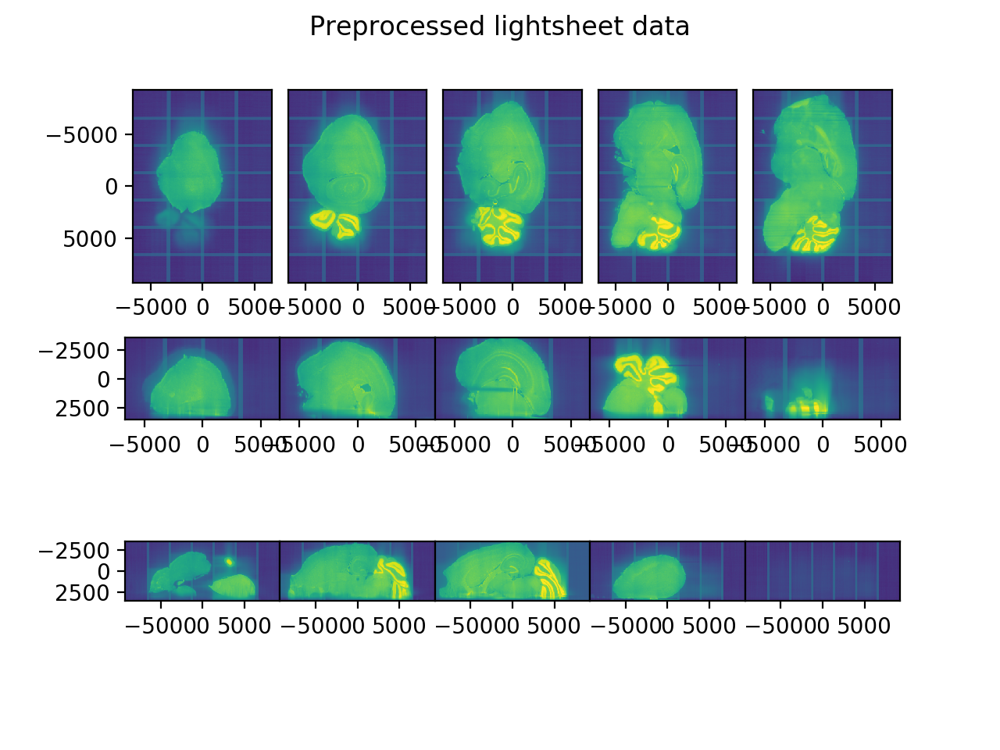

4294967296 4294967296


In [25]:
J = I0tv.detach().clone().cpu().numpy()[None,npad:-npad,npad:-npad,npad:-npad]
#J = I0t.detach().clone().cpu().numpy()[None,npad:-npad,npad:-npad,npad:-npad] # forget it
J /= np.mean(np.abs(J))
fig,ax = emlddmm.draw(J,xJ)
fig.suptitle('Preprocessed lightsheet data')
fig.savefig(output_prefix + 'processed.jpg',**figopts)

## Atlas preprocessing


In [26]:
# pad
# since I will downsample by 4, I want to pad with 4x4x4
npad = 4
I = np.pad(I,  ((0,0),(npad,npad),(npad,npad),(npad,npad)) )
for i in range(npad):
    xI = [ np.concatenate(   (x[0][None]-d,x,x[-1][None]+d)   ) for d,x in zip(dI,xI)]


In [27]:
# nissl image dynamic range
I[0] = I[0]**0.25
I[0] /= np.mean(np.abs(I[0]))

/home/dtward/data/csh_data/emlddmm/emlddmm.py:80: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


<IPython.core.display.Javascript object>


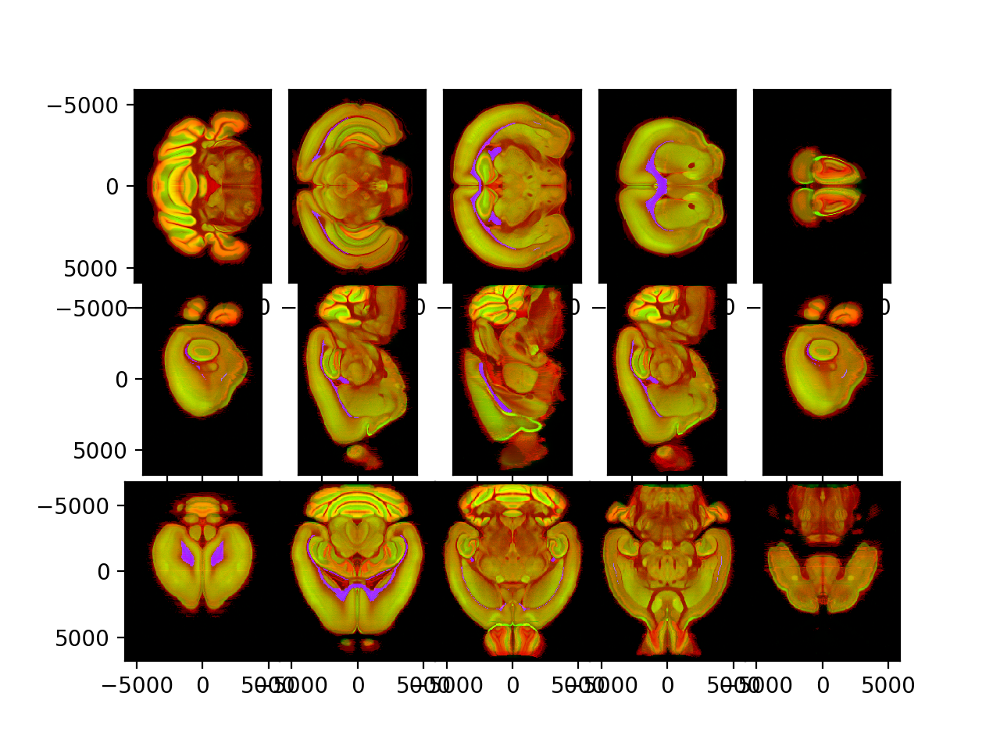

In [28]:
fig,ax = emlddmm.draw(I,xI,vmin=0)
fig.canvas.draw()

# Registration

/home/dtward/data/csh_data/emlddmm/emlddmm.py:2541: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  ../torch/csrc/utils/tensor_new.cpp:201.)
  X = torch.as_tensor(X,dtype=self.data.dtype,device=self.data.device)


<IPython.core.display.Javascript object>


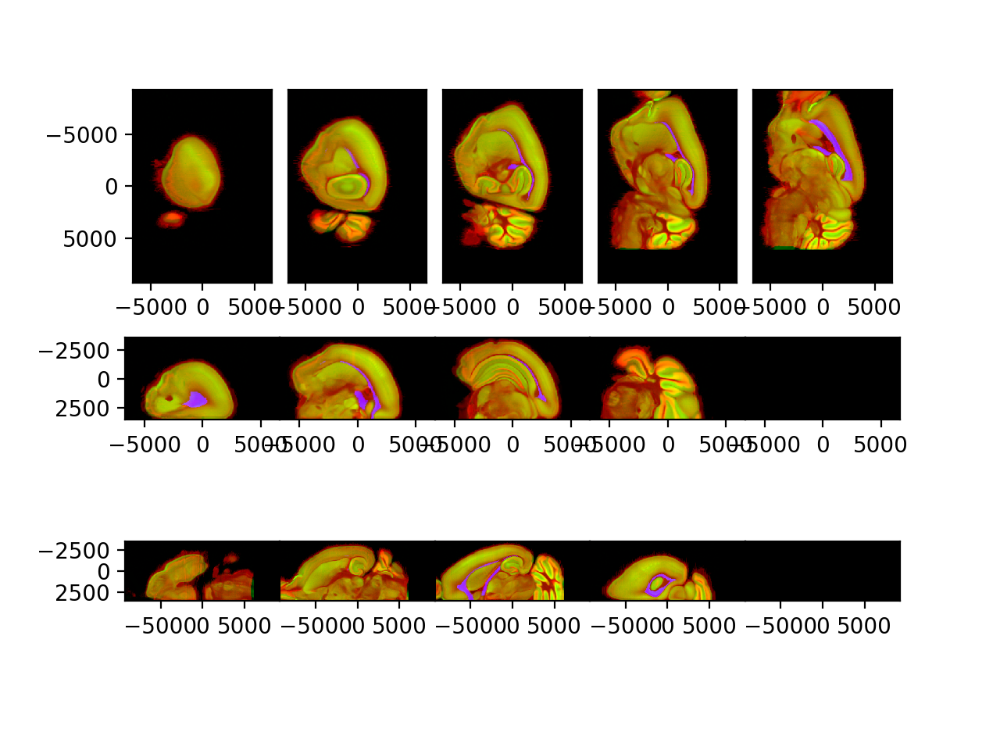

In [29]:
# initial affine
# make sure to keep sign of Jacobian
A0 = np.diag((1.3,1.3,1.3,1.0))
# flip x0,x1
A0 = np.array([[0.0,-1.0,0.0,0.0],[1.0,0.0,0.0,0.0],[0.0,0.0,1.0,0.0],[0.0,0.0,0.0,1.0]])@A0
# flip x0,x2
#A0 = np.array([[0.0,0.0,-1.0,0.0],[0.0,1.0,0.0,0.0],[1.0,0.0,0.0,0.0],[0.0,0.0,0.0,1.0]])@A0
# flip x1,x2
#A0 = np.array([[-1.0,0.0,0.0,0.0],[0.0,0.0,1.0,0.0],[0.0,1.0,0.0,0.0],[0.0,0.0,0.0,1.0]])@A0
# flip 
A0 = np.diag((1.0,-1.0,-1.0,1.0))@A0
# shift
A0[0,-1] = +3500 # left right, positive will cut off the missing hemisphere as appropriate
A0[1,-1] = -2500 # AP, negative will cut off the nose
A0[2,-1] = -1000 # SI, negative will move the venttral surface toward the boundary

# check it
XJ = np.meshgrid(*xJ,indexing='ij')
tform = emlddmm.Transform(A0,direction='b')
AI = emlddmm.apply_transform_float(xI,I,tform.apply(XJ))
fig,ax = emlddmm.draw(np.concatenate((AI,J)),xJ,vmin=0)
fig.canvas.draw()


/home/dtward/data/csh_data/emlddmm/emlddmm.py:1018: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figE,axE = plt.subplots(1,3)


<IPython.core.display.Javascript object>


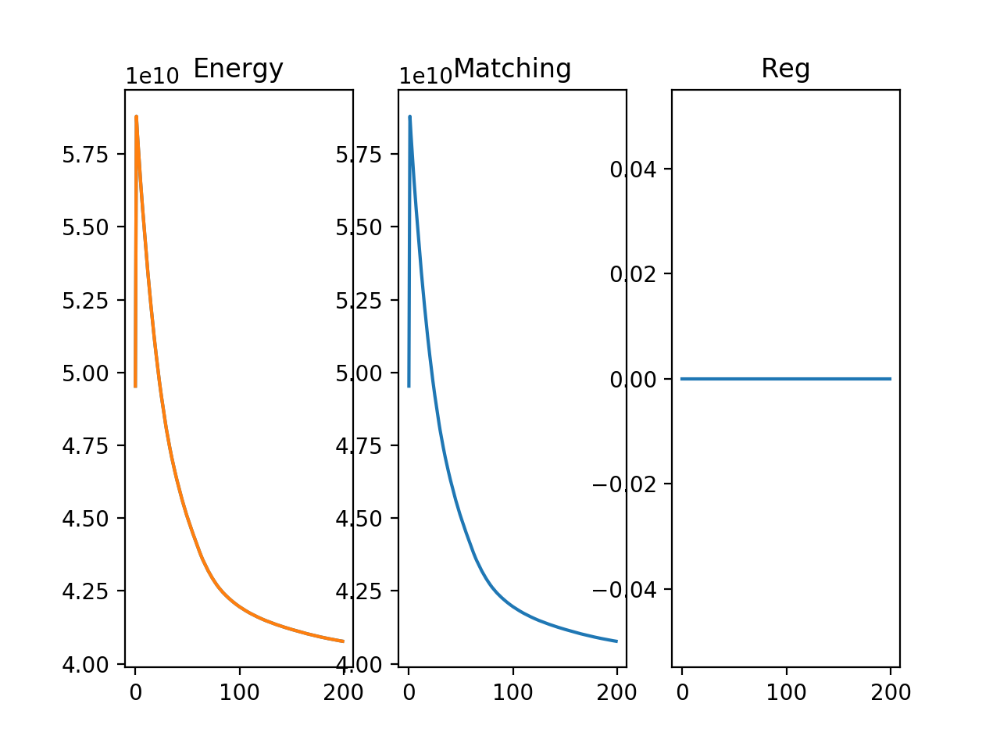

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1019: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figA,axA = plt.subplots(2,2)


<IPython.core.display.Javascript object>


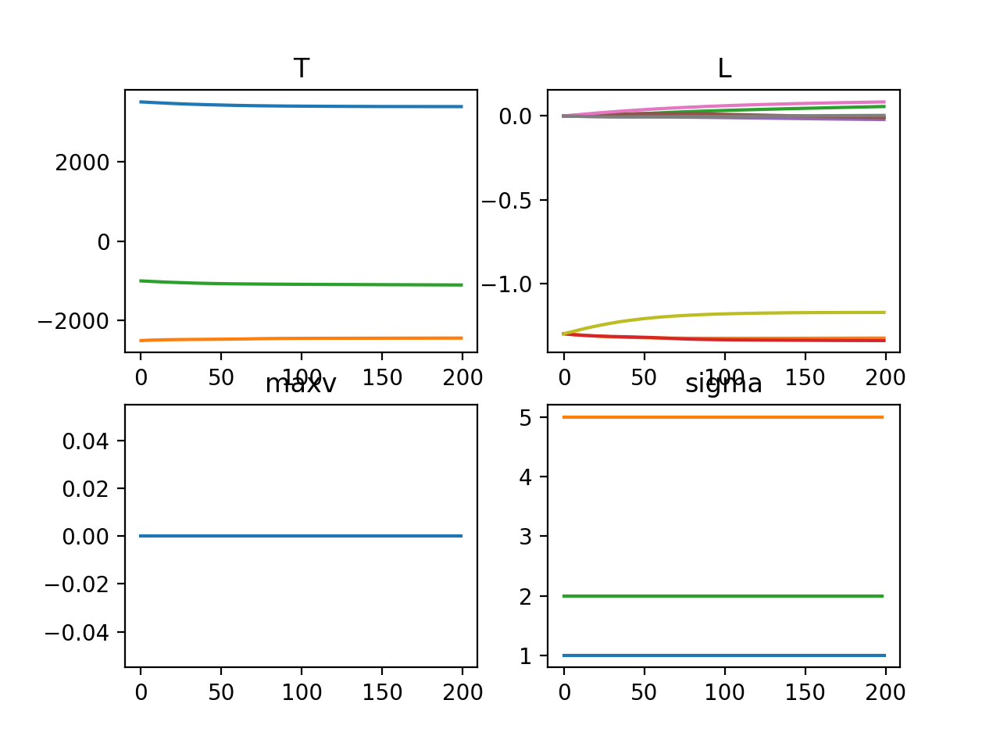

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1024: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figI = plt.figure()


<IPython.core.display.Javascript object>


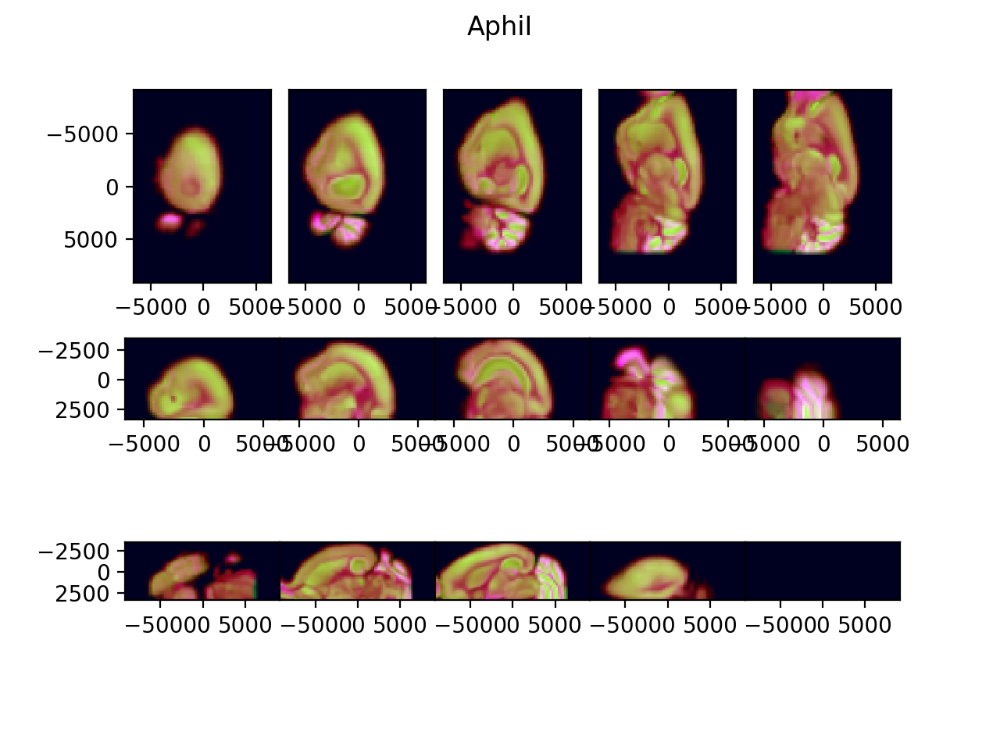

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1025: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figfI = plt.figure()


<IPython.core.display.Javascript object>


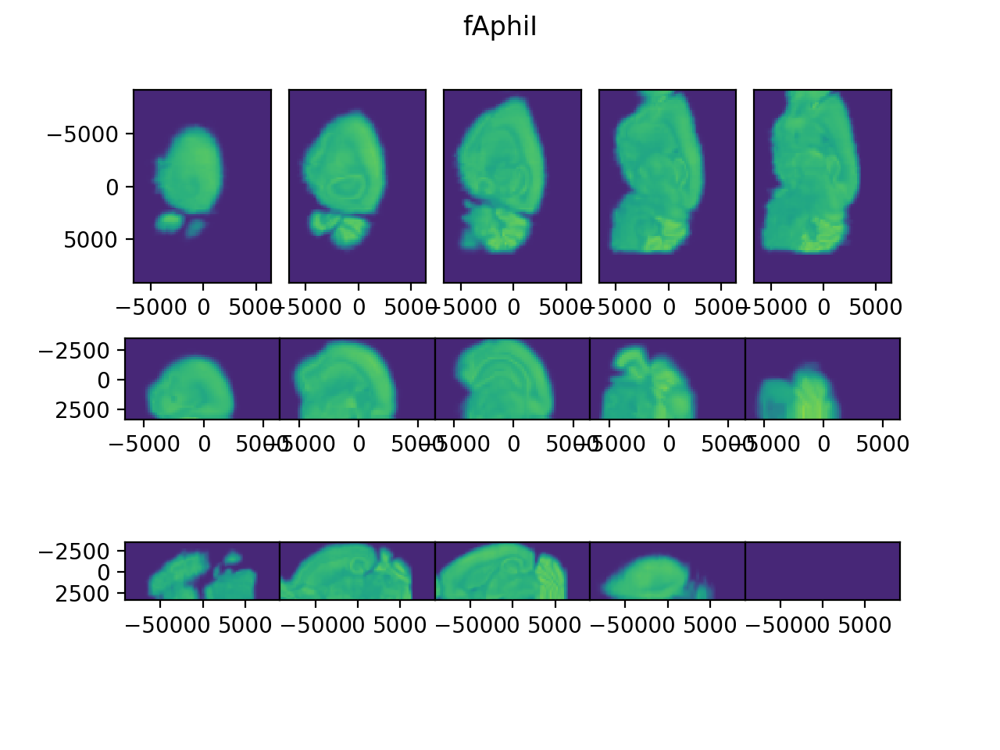

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1026: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figErr = plt.figure()


<IPython.core.display.Javascript object>


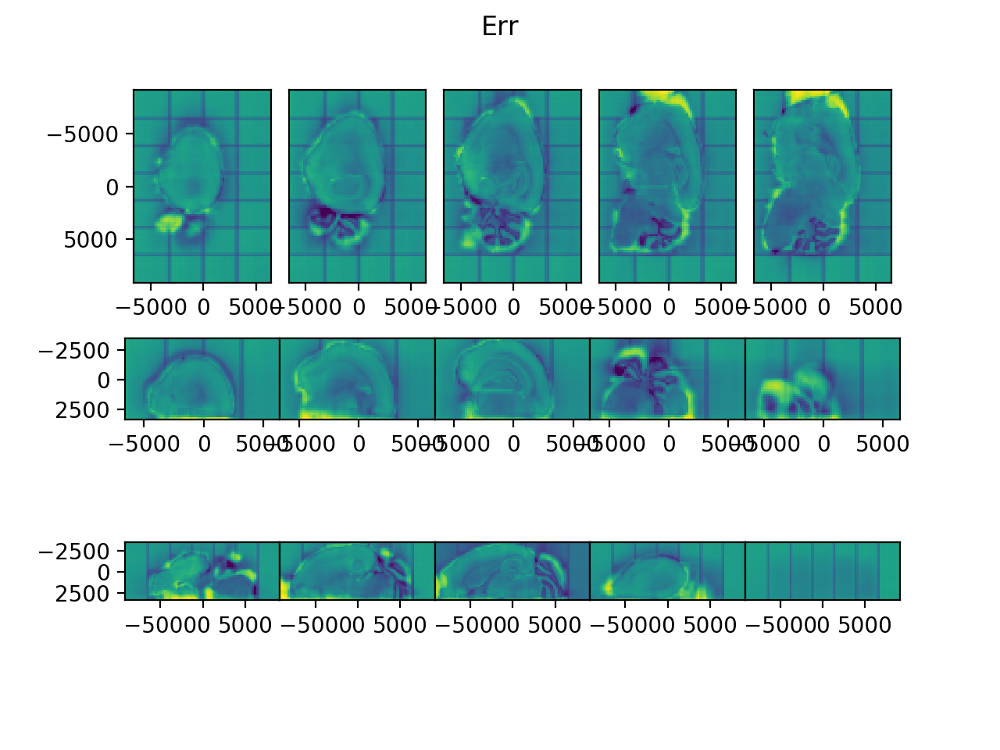

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1027: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figJ = plt.figure()


<IPython.core.display.Javascript object>


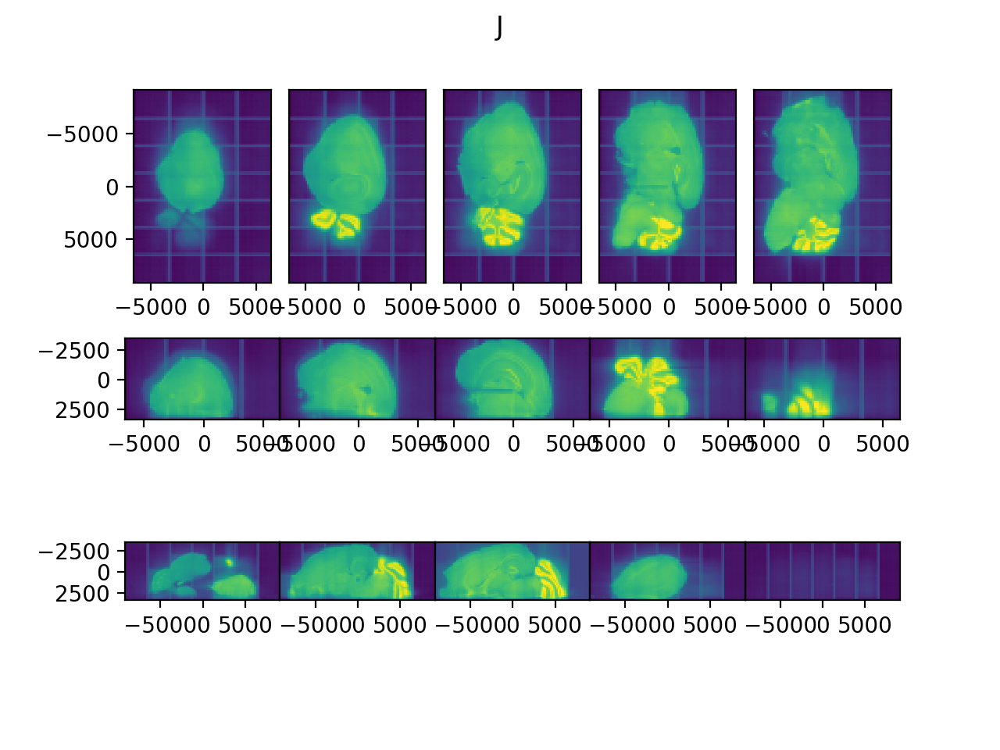

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1028: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figV = plt.figure()


<IPython.core.display.Javascript object>


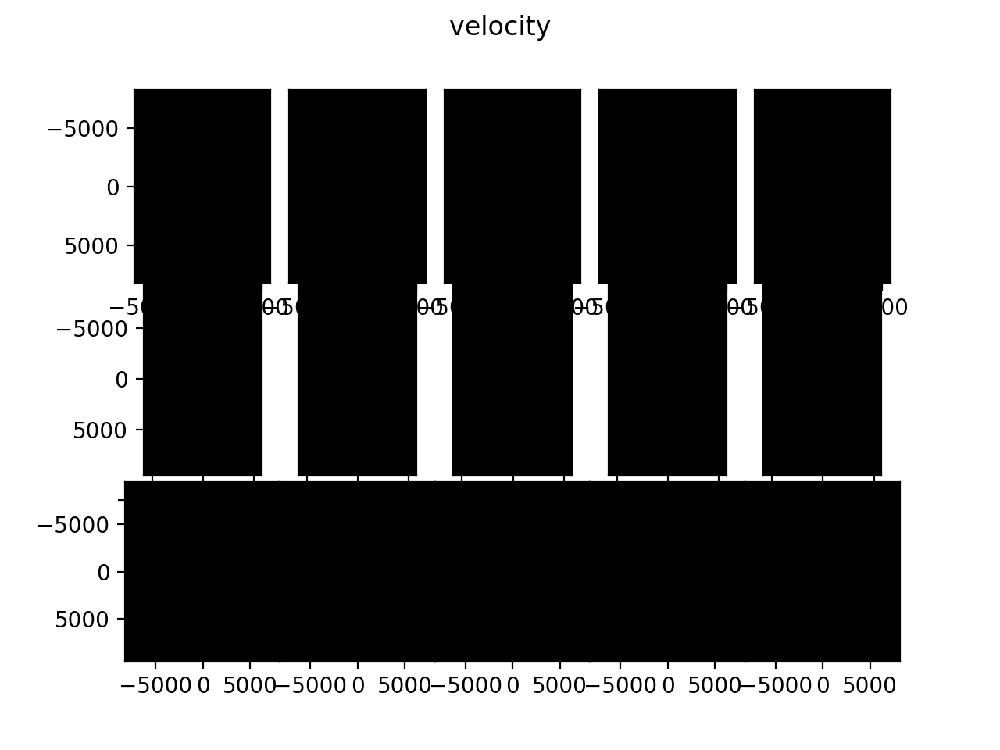

/home/dtward/data/csh_data/emlddmm/emlddmm.py:1029: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figW = plt.figure()


<IPython.core.display.Javascript object>


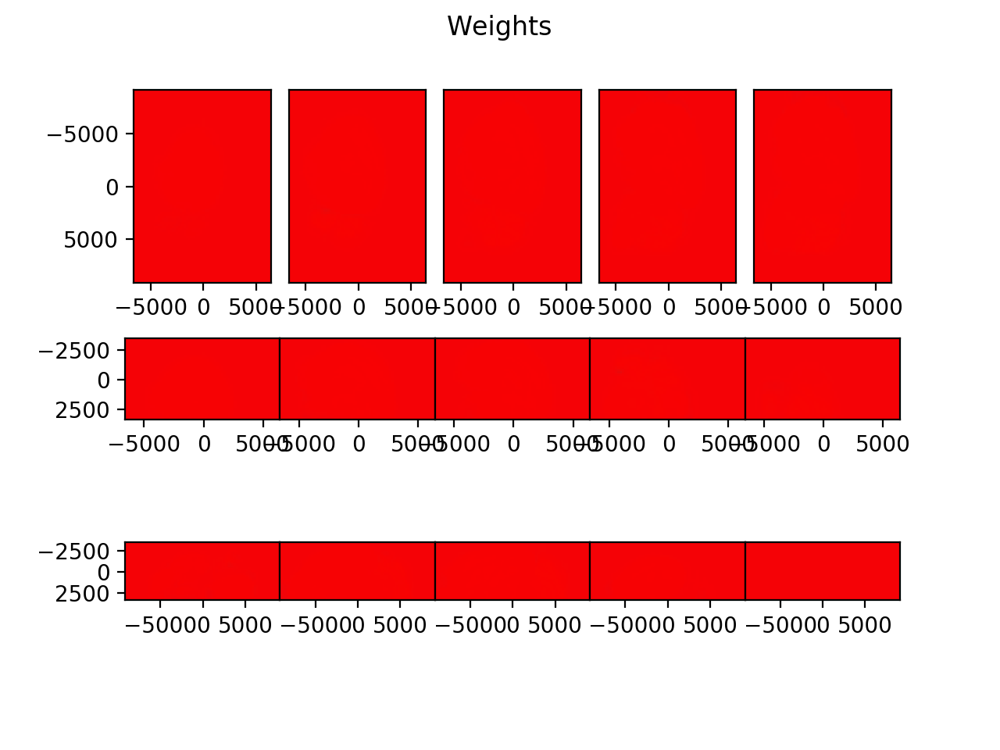

/home/dtward/.local/intelpython3/lib/python3.7/site-packages/torch/autograd/__init__.py:156: UserWarning: Casting complex values to real discards the imaginary part (Triggered internally at  ../aten/src/ATen/native/Copy.cpp:244.)
  allow_unreachable=True, accumulate_grad=True)  # allow_unreachable flag
/home/dtward/data/csh_data/emlddmm/emlddmm.py:96: RuntimeWarning: invalid value encountered in true_divide
  J /= (vmax[:,None,None,None] - vmin[:,None,None,None])


In [30]:
# now we want to register
# we'll start with an affine registration
import imp
imp.reload(emlddmm)
config0 = {
    'device':'cpu',
    'n_iter':200, 'downI':[4,4,4], 'downJ':[4,4,4],
     'priors':[0.9,0.05,0.05],'update_priors':False,
     'update_muA':0,'muA':[np.quantile(J,0.99)],
     'update_muB':0,'muB':[0.0],
     'update_sigmaM':0,'update_sigmaA':0,'update_sigmaB':0,
     'sigmaM':1.0,'sigmaB':2.0,'sigmaA':5.0,
     'order':1,'n_draw':50,'n_estep':3,'slice_matching':0,'v_start':1000,
     'eA':2e5,'A':A0,'full_outputs':True,
   }

W = 1.0 - (J[0]==0)
#I_ = np.stack((I[0],I[1],I[0]**2,I[0]*I[1],I[1]**2,))
#I_ = np.stack((I[2],I[0],I[1],I[0]**2,I[0]*I[1],I[1]**2))
#I_ = np.stack((I[0],I[1],I[0]*I[1],I[0]**2,I[1]**2)) # I don't need I[2]
I_ = np.stack((I[0]-np.mean(I[0]),I[1]-np.mean(I[1]),
               (I[0]-np.mean(I[0]))**2,
               (I[0]-np.mean(I[0]))*(I[1]-np.mean(I[1])),
               (I[1]-np.mean(I[0]))**2,))

out = emlddmm.emlddmm(xI=xI,I=I_,xJ=xJ,J=J, W0=W, **config0)

In [ ]:
np.std(J)

In [ ]:
# now we want to register
# we'll start with an affine registration
# this is a version 2, since there is definitely missing tissue, we need to make sure we can model it.
import imp
imp.reload(emlddmm)
config0 = {
    'device':'cuda:0',
    'n_iter':200, 'downI':[4,4,4], 'downJ':[4,4,4],
     'priors':[0.9,0.05,0.05],'update_priors':False,
     'update_muA':0,'muA':[np.quantile(J,0.99)],
     'update_muB':0,'muB':[0.0],
     'update_sigmaM':0,'update_sigmaA':0,'update_sigmaB':0,
     'sigmaM':0.25,'sigmaB':0.5,'sigmaA':1.25,
     'order':1,'n_draw':50,'n_estep':3,'slice_matching':0,'v_start':1000,
     'eA':5e4,'A':A0,'full_outputs':True,
   }

W = 1.0 - (J[0]==0)
#I_ = np.stack((I[0],I[1],I[0]**2,I[0]*I[1],I[1]**2,))
#I_ = np.stack((I[2],I[0],I[1],I[0]**2,I[0]*I[1],I[1]**2))
#I_ = np.stack((I[0],I[1],I[0]*I[1],I[0]**2,I[1]**2)) # I don't need I[2]
I_ = np.stack((I[0]-np.mean(I[0]),I[1]-np.mean(I[1]),
               (I[0]-np.mean(I[0]))**2,
               (I[0]-np.mean(I[0]))*(I[1]-np.mean(I[1])),
               (I[1]-np.mean(I[0]))**2,))

out = emlddmm.emlddmm(xI=xI,I=I_,xJ=xJ,J=J, W0=W, **config0)

/home/dtward/data/csh_data/emlddmm/emlddmm.py:970: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(A,device=device,dtype=dtype).detach().clone()


<IPython.core.display.Javascript object>


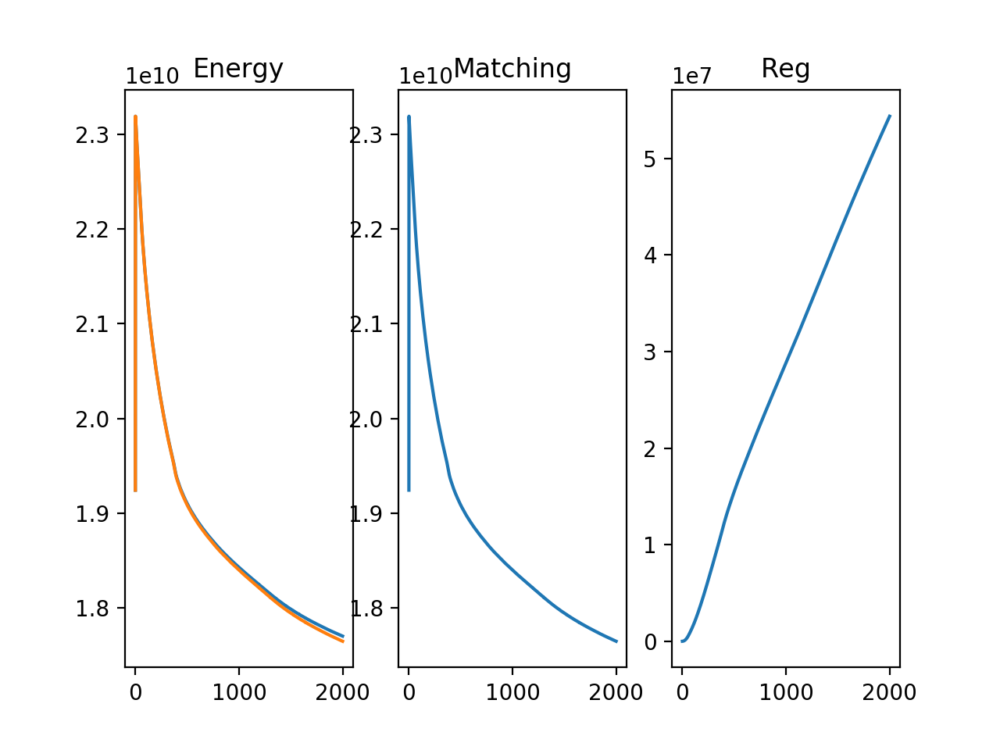

<IPython.core.display.Javascript object>


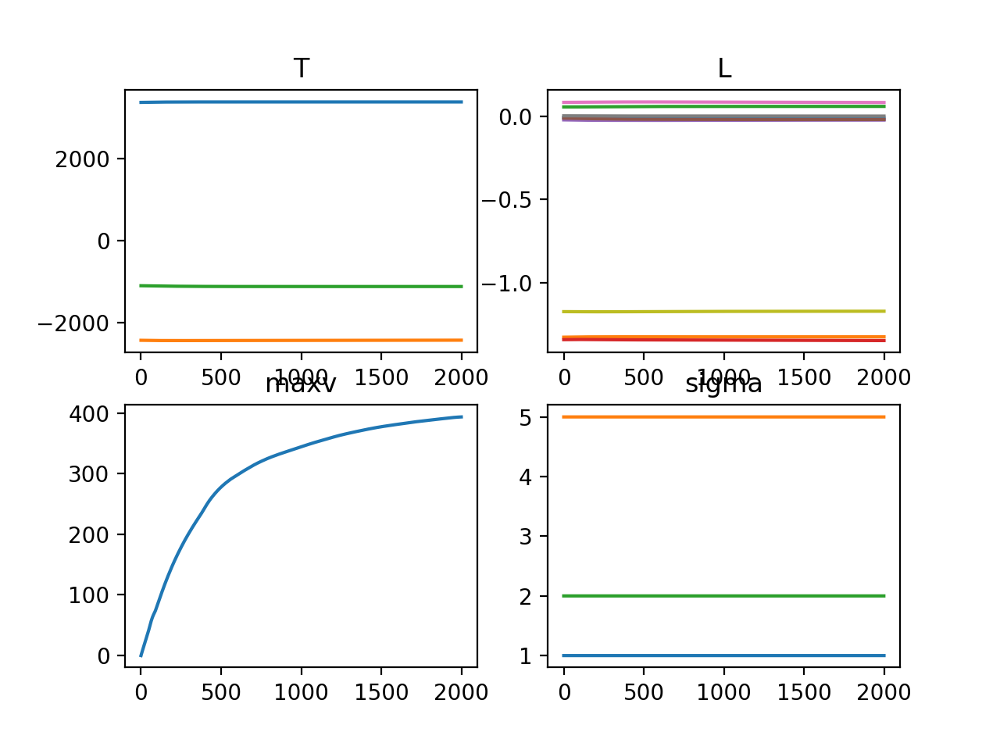

<IPython.core.display.Javascript object>


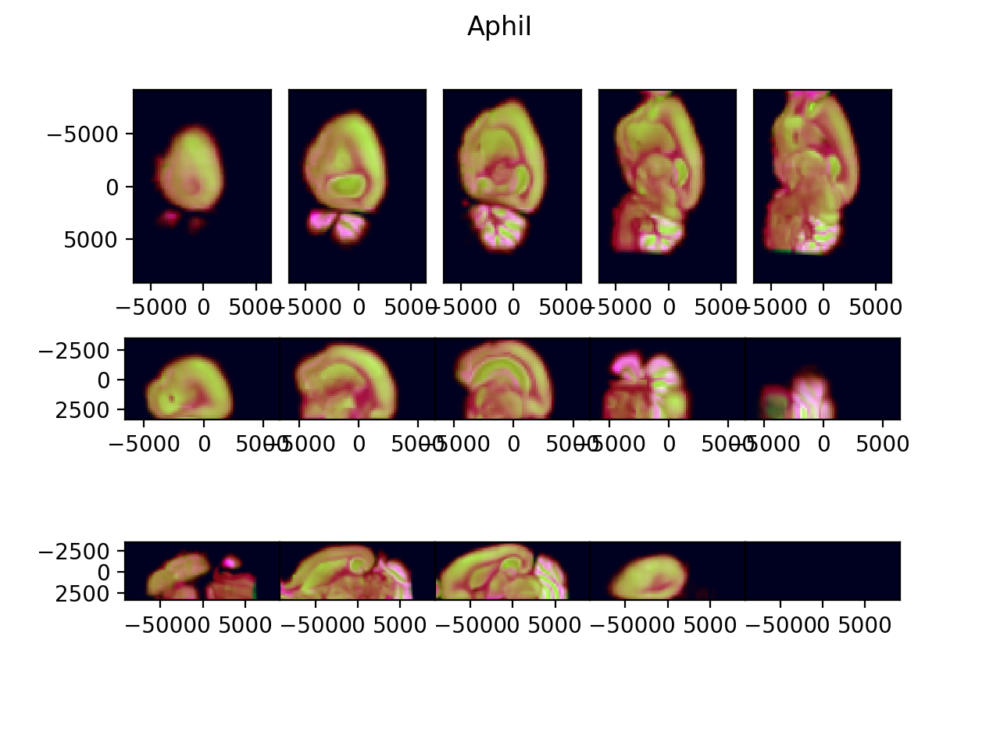

<IPython.core.display.Javascript object>


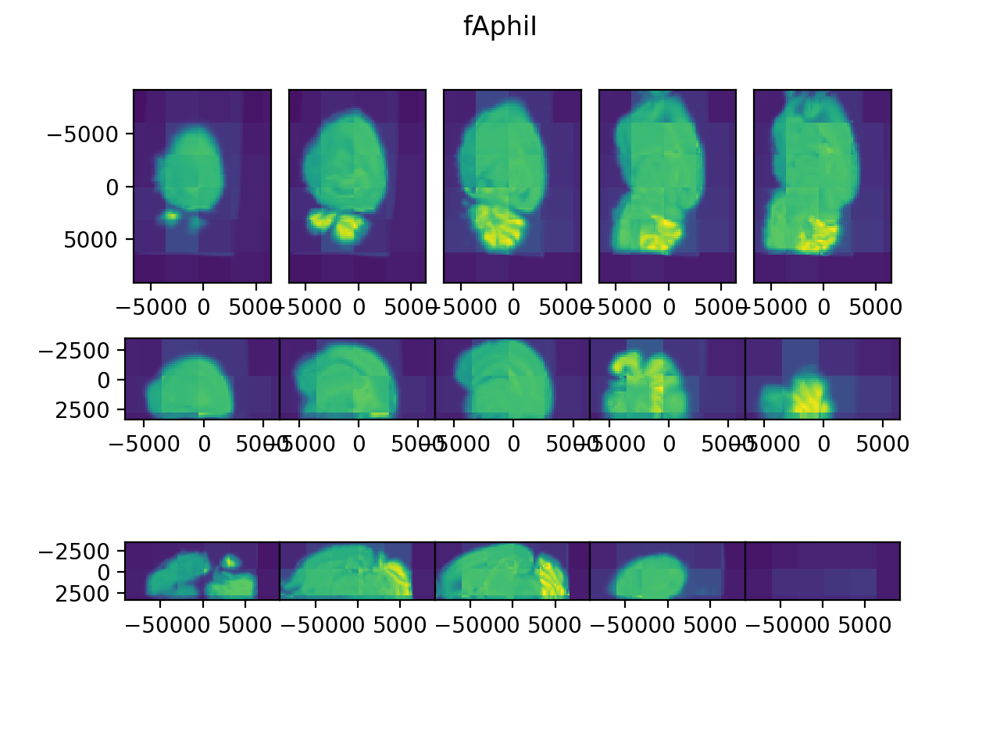

<IPython.core.display.Javascript object>


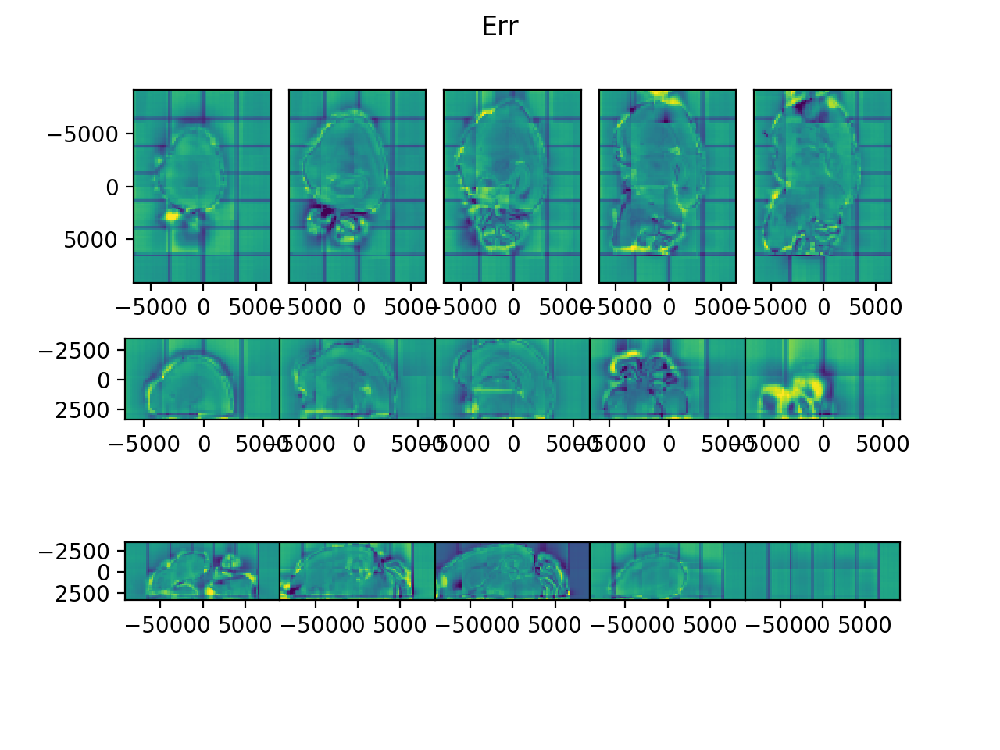

<IPython.core.display.Javascript object>


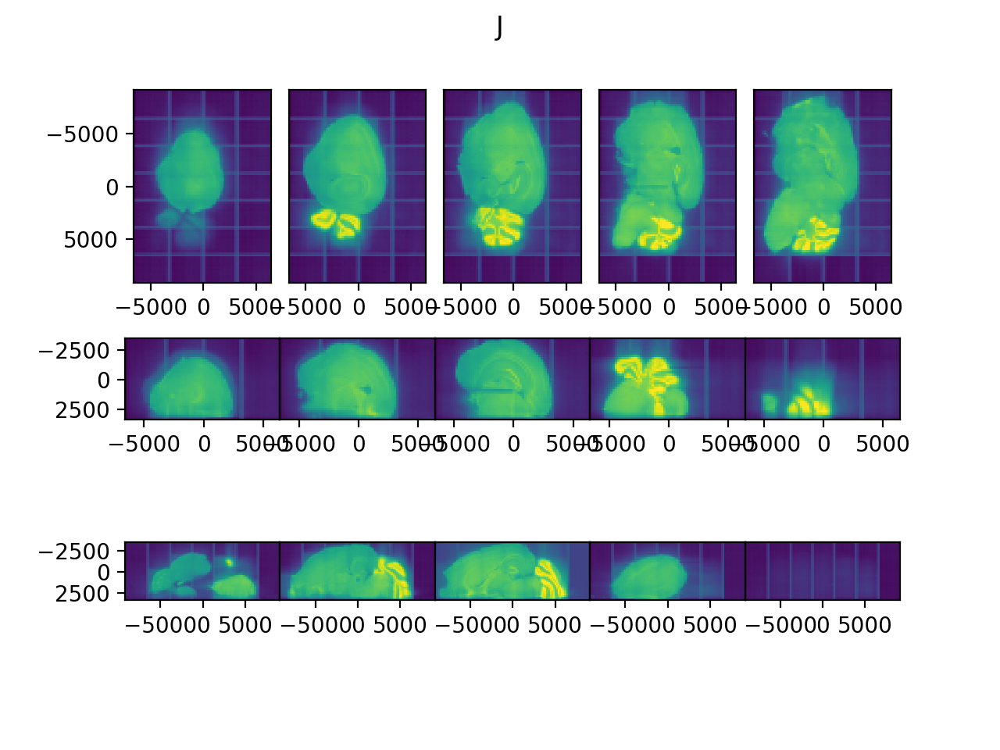

<IPython.core.display.Javascript object>


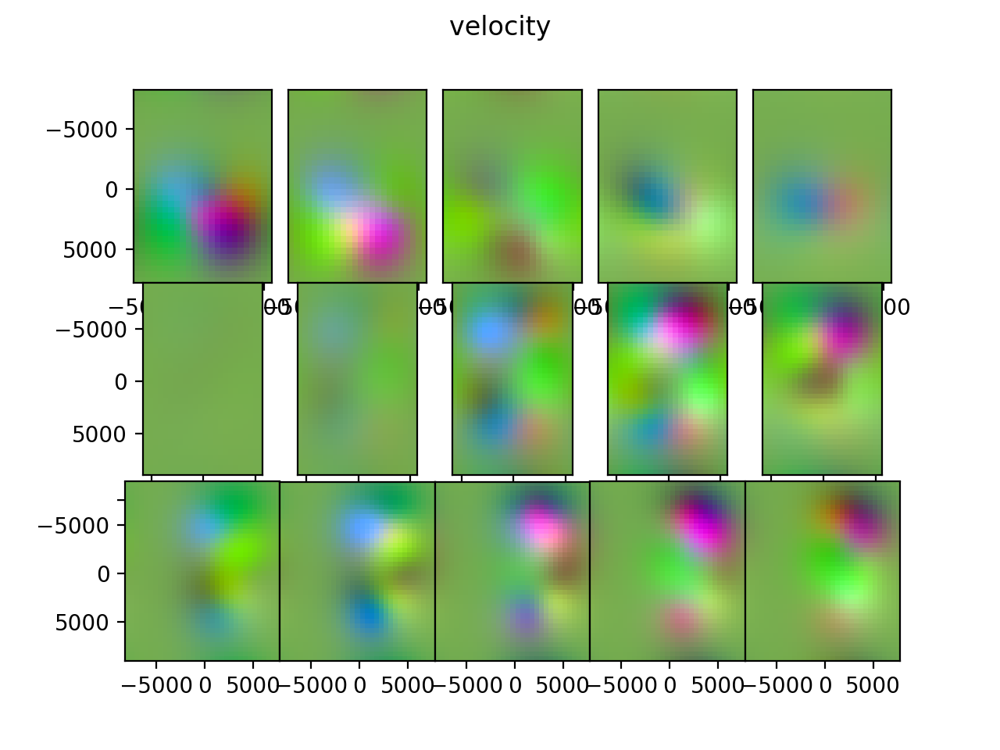

<IPython.core.display.Javascript object>


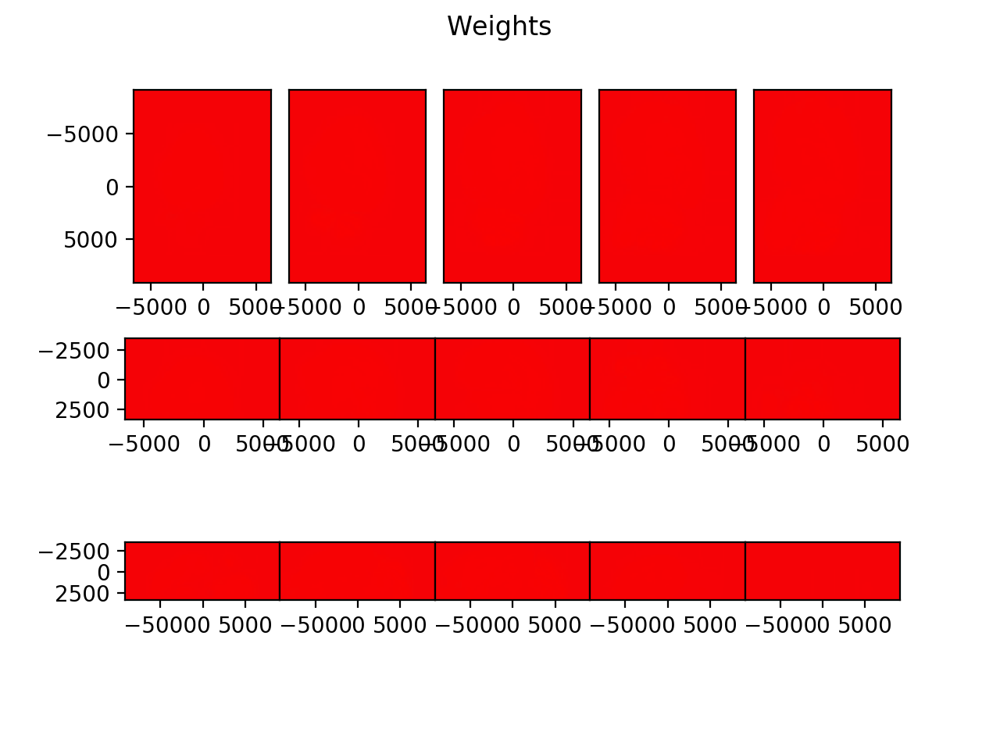

Iteration 230, linear oscilating, reducing eA to 18000.0
Iteration 410, translation oscilating, reducing eA to 16200.0
Iteration 1680, linear oscilating, reducing eA to 14580.0


In [56]:
# second run, with deformation
imp.reload(emlddmm)
config1 = dict(config0)
config1['A'] = out['A']
config1['eA'] = config0['eA']*0.1
config1['a'] = 1000.0
config1['sigmaR'] = 5e4 # 1e4 gave really good results, but try 2e4, also good, I showed this in my slides
config1['n_iter']= 2000
config1['v_start'] = 0
config1['ev'] = 1e-2
config1['ev'] = 2e-3 # reduce since I decreased sigma
config1['v_res_factor'] = config1['a']/dI[0]/2 # what is the resolution of v, as a multiple of that in I
config1['local_contrast'] = [32,32,32]
config1['local_contrast'] = [16,16,16]
config1['device'] = 'cpu'

#I_ = np.stack((I[2],I[0],I[1],I[0]**2,I[0]*I[1],I[1]**2,))

# note this approach has an issue with background being black
#I_ = np.stack((I[2],I[0]-np.mean(I[0]),I[1]-np.mean(I[1]),
#               (I[0]-np.mean(I[0]))**2,
#               (I[0]-np.mean(I[0]))*(I[1]-np.mean(I[1])),
#               (I[1]-np.mean(I[0]))**2,))
I_ = np.stack((I[0]-np.mean(I[0]),I[1]-np.mean(I[1]),
               (I[0]-np.mean(I[0]))**2,
               (I[0]-np.mean(I[0]))*(I[1]-np.mean(I[1])),
               (I[1]-np.mean(I[0]))**2,))


out1 = emlddmm.emlddmm(xI=xI,I=I_,xJ=xJ,J=J, W0=W, **config1)

In [ ]:
1

/home/dtward/data/csh_data/emlddmm/emlddmm.py:955: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  v = torch.tensor(v,device=device,dtype=dtype)


<IPython.core.display.Javascript object>


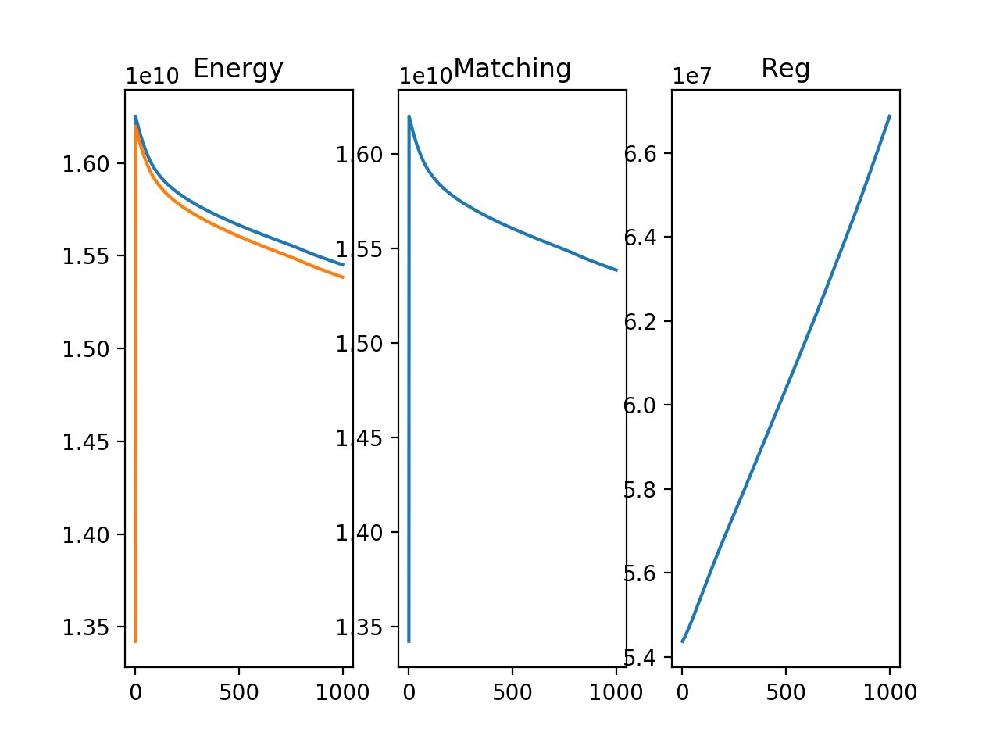

<IPython.core.display.Javascript object>


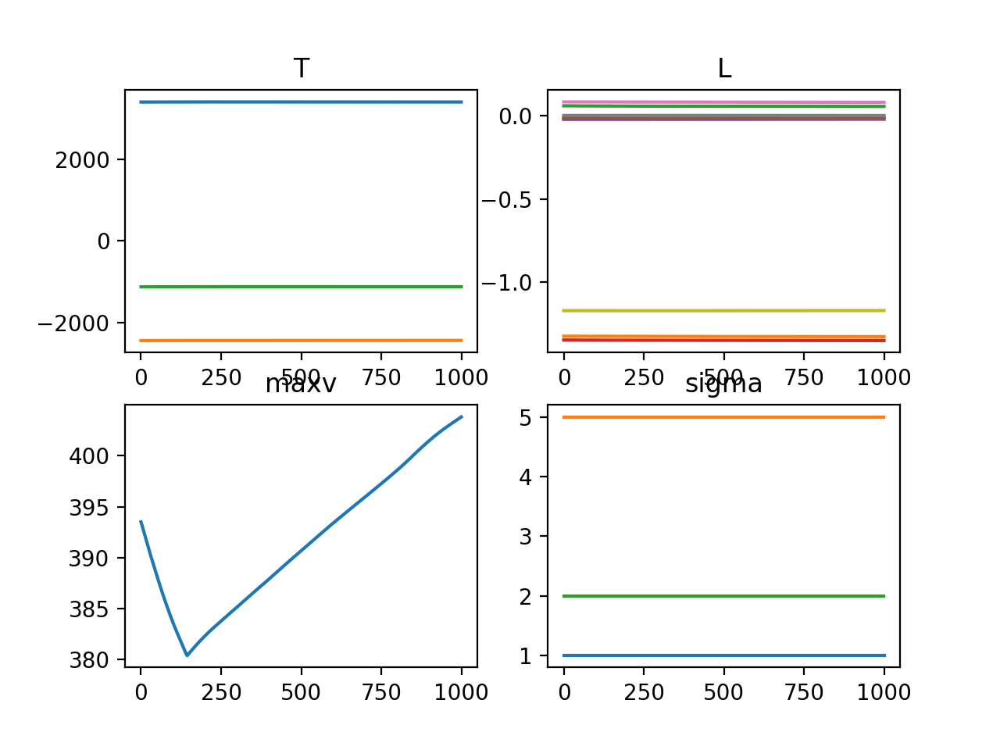

<IPython.core.display.Javascript object>


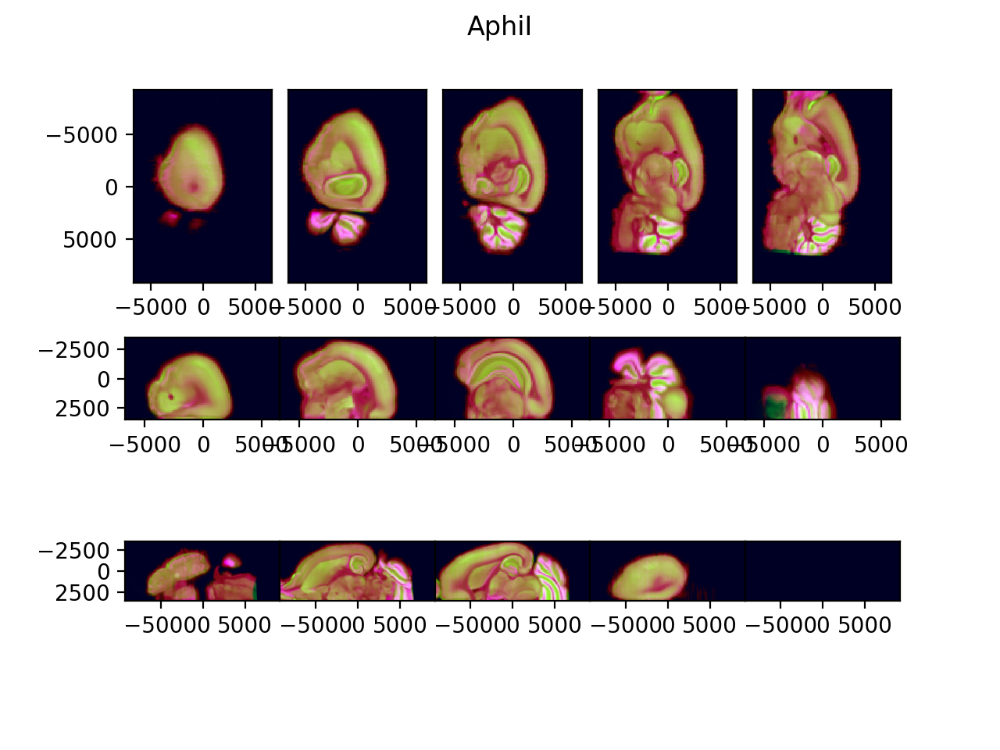

<IPython.core.display.Javascript object>


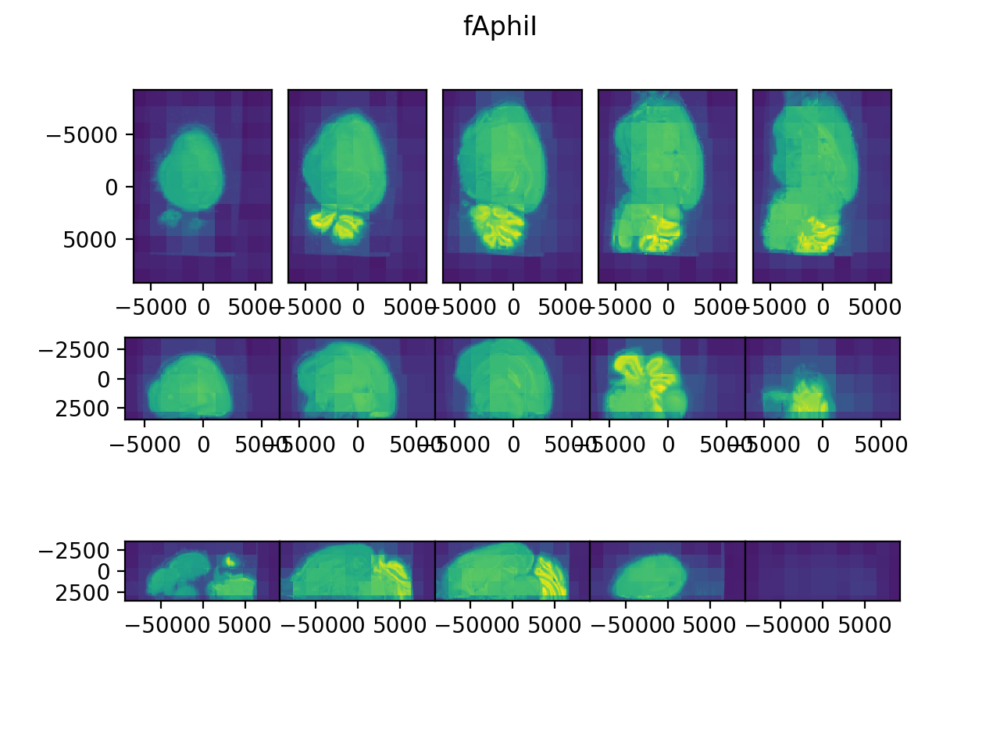

<IPython.core.display.Javascript object>


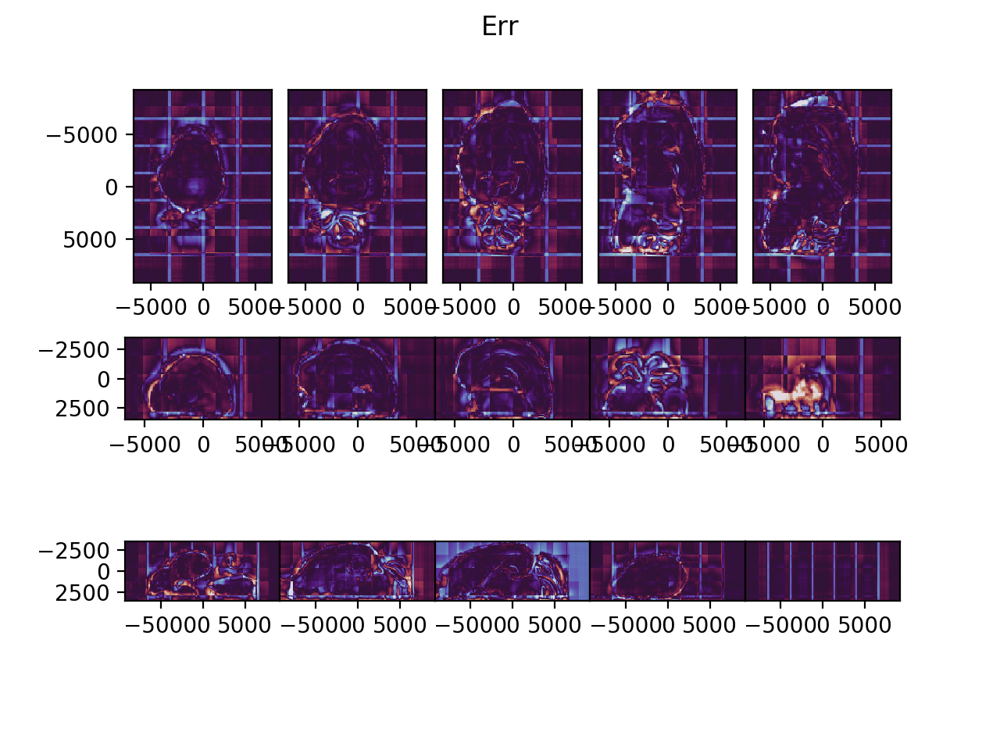

<IPython.core.display.Javascript object>


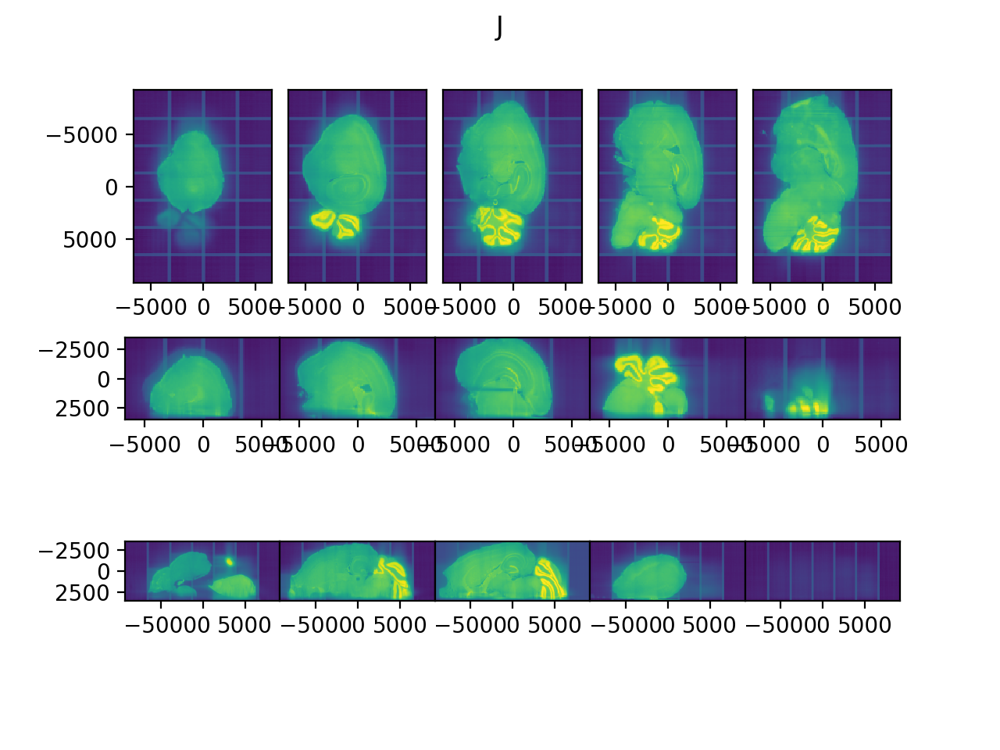

<IPython.core.display.Javascript object>


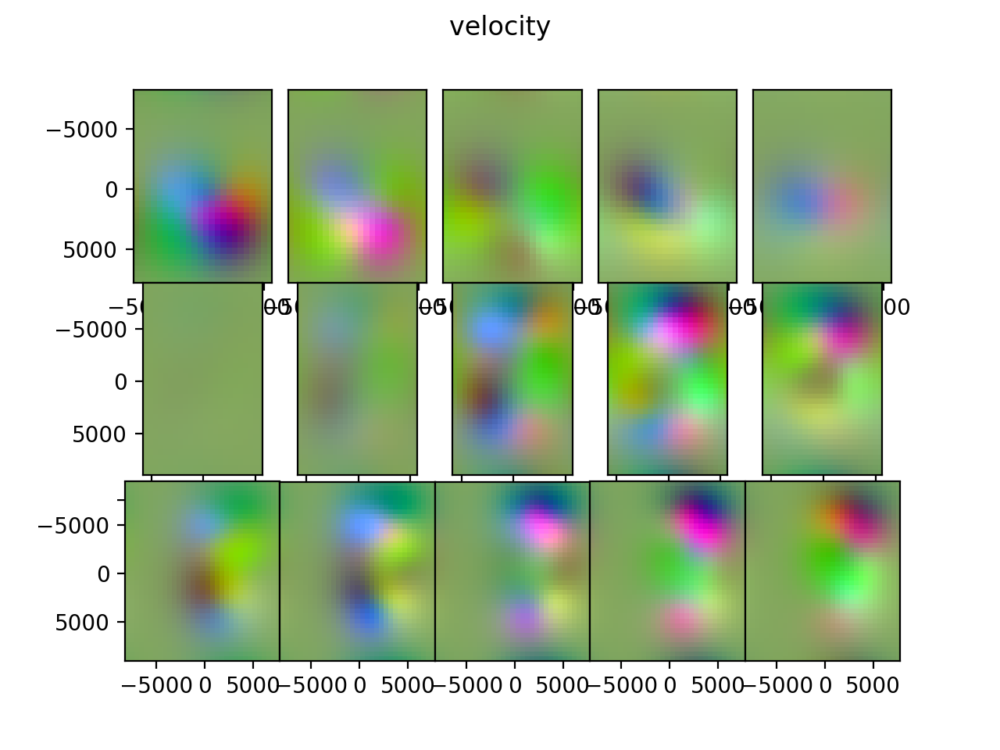

<IPython.core.display.Javascript object>


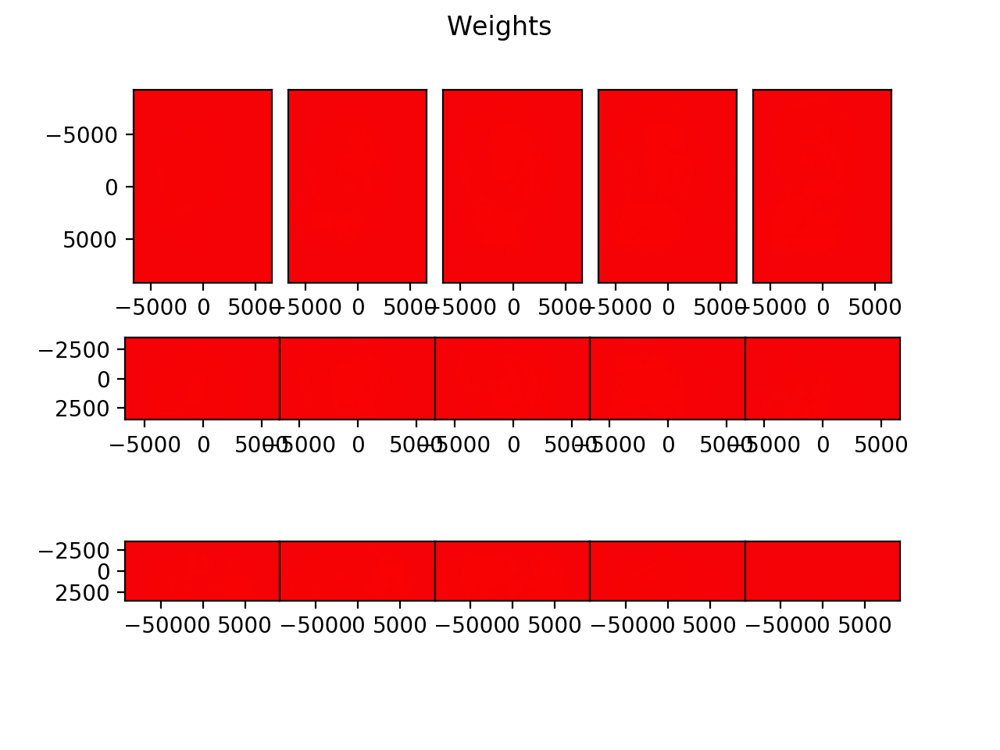

In [67]:
imp.reload(emlddmm)
# on the next run we do les downsampling
config2 = dict(config1)
config2['A'] = out1['A']
config2['n_iter']= 1000
config2['v'] = out1['v']
config2['downI'] = [2,2,2]
config2['downJ'] = [2,2,2]
# there seems to be an issue with the initial velocity
# when I run this twice, I'm reusing it
out2 = emlddmm.emlddmm(xI=xI,I=I_,xJ=xJ,J=J, W0=W, **config2)
# the matching energy here is way way lower, why would that be?

In [68]:
out2['coeffs']

tensor([[[[[ 5.1533e-01],
           [-4.7925e-01],
           [ 1.7423e-01],
           [ 5.6630e-01],
           [-1.6088e-01],
           [-8.4469e-01]],

          [[ 3.0174e-01],
           [-3.1988e-01],
           [ 6.1723e-02],
           [ 3.0939e-01],
           [-6.7209e-02],
           [-3.6555e-01]],

          [[ 4.9406e-01],
           [-5.4096e-01],
           [ 9.0844e-02],
           [ 4.6103e-01],
           [-6.0962e-02],
           [-8.6378e-01]],

          ...,

          [[ 1.7629e+00],
           [-2.0898e+00],
           [ 1.0245e+00],
           [ 1.9516e+00],
           [-9.8731e-01],
           [-3.6074e+00]],

          [[ 8.1903e-02],
           [-6.3662e-02],
           [-7.2024e-02],
           [ 7.7780e-02],
           [ 7.8197e-02],
           [ 7.7780e-02]],

          [[ 7.8141e-02],
           [-7.8875e-02],
           [-7.7676e-02],
           [ 8.2049e-02],
           [ 7.1155e-02],
           [ 8.2049e-02]]],


         [[[ 6.2135e-01],
        

In [69]:
# save the outputs
savename = 'transformation_outputs_lightsheet_v03c.npz'
#np.savez(output_prefix+savename,out=out)
# NOTE: come back to this
# the outs may not be getting saved well, can't seem to read them
savename = 'transformation_outputs_lightsheet_v03c.npy'
np.save(output_prefix+savename,np.array([out2],dtype=object))

In [70]:

out2['figI'].savefig(output_prefix + 'transformed.jpg',**figopts)
out2['figfI'].savefig(output_prefix + 'contrast.jpg',**figopts)
out2['figErr'].savefig(output_prefix + 'err.jpg',**figopts)

4294967296 4294967296
4294967296 4294967296
4294967296 4294967296


In [71]:
fig = out2['figErr']
axs = fig.get_axes()
for ax in axs:
    ims = ax.get_images()
    for im in ims:
        im.set_cmap('twilight')
        clim = im.get_clim()
        lim = np.max(np.abs(clim))
        im.set_clim(np.array((-1,1))*lim)
fig.canvas.draw()
fig.savefig(output_prefix + 'err.jpg',**figopts)

4294967296 4294967296


In [72]:
fig.canvas.draw()

In [73]:
[k for k in out1]

['A',
 'v',
 'xv',
 'WM',
 'WA',
 'WB',
 'W0',
 'muB',
 'muA',
 'sigmaB',
 'sigmaA',
 'sigmaM',
 'coeffs',
 'figA',
 'figE',
 'figI',
 'figfI',
 'figErr',
 'figJ',
 'figW',
 'figV']

In [74]:
# out2 = out # temporary
#out2 = out1 # temporary
# transform the labels
deformation = emlddmm.Transform(out2['v'],domain=out2['xv'],direction='b')
affine = emlddmm.Transform(out2['A'],direction='b')
tform = emlddmm.compose_sequence([affine,deformation],XJ)

In [75]:
It = emlddmm.apply_transform_float(xI,I,tform).cpu().numpy()
RGBt = emlddmm.apply_transform_float(xI,RGB,tform).cpu().numpy()


In [76]:
imp.reload(emlddmm)
St = emlddmm.apply_transform_int(xS,S,tform,double=True,padding_mode='zeros').cpu().numpy()

<IPython.core.display.Javascript object>


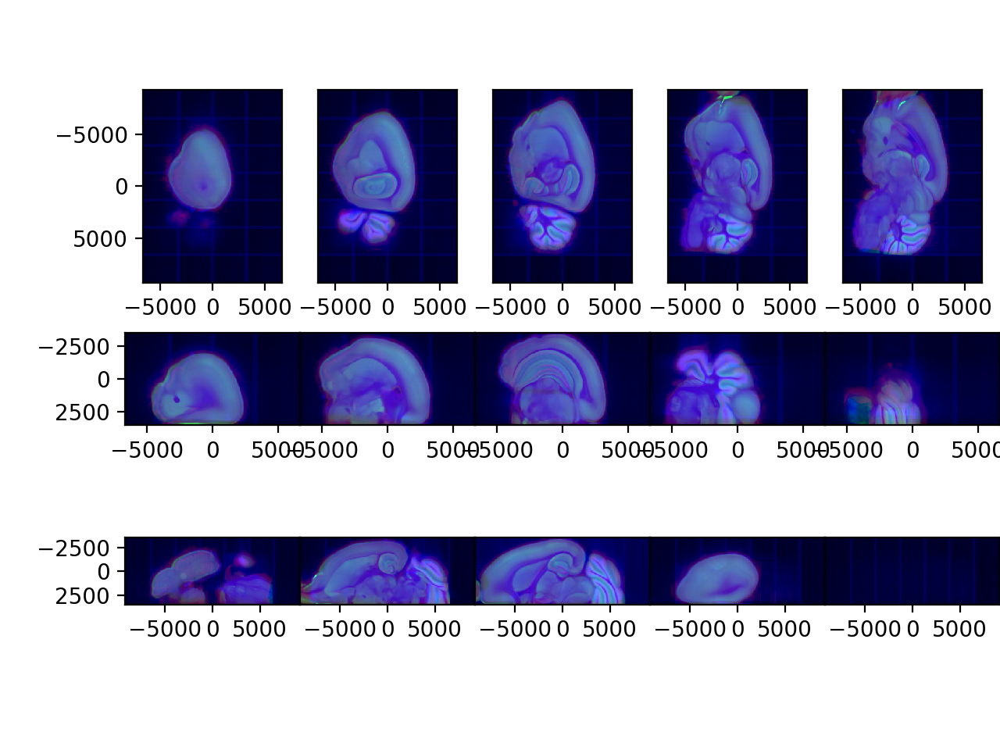

<IPython.core.display.Javascript object>


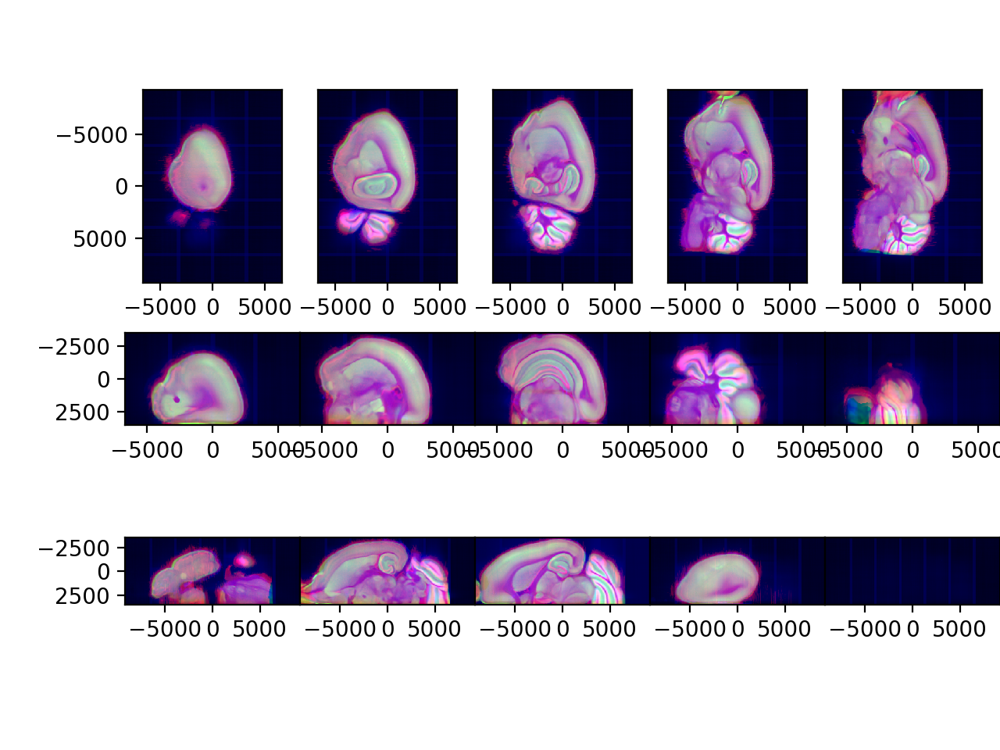

In [77]:
fig,ax = emlddmm.draw(np.stack((It[0]*0.5,It[1]*0.5,Jsave[0]*1.5)),xJ,vmin=0,vmax=4)
fig.subplots_adjust(wspace=0,hspace=0,right=1)
fig,ax = emlddmm.draw(np.stack((It[0]*0.5,It[1]*0.5,Jsave[0]*1.5)),xJ,)
fig.subplots_adjust(wspace=0,hspace=0,right=1)

<IPython.core.display.Javascript object>


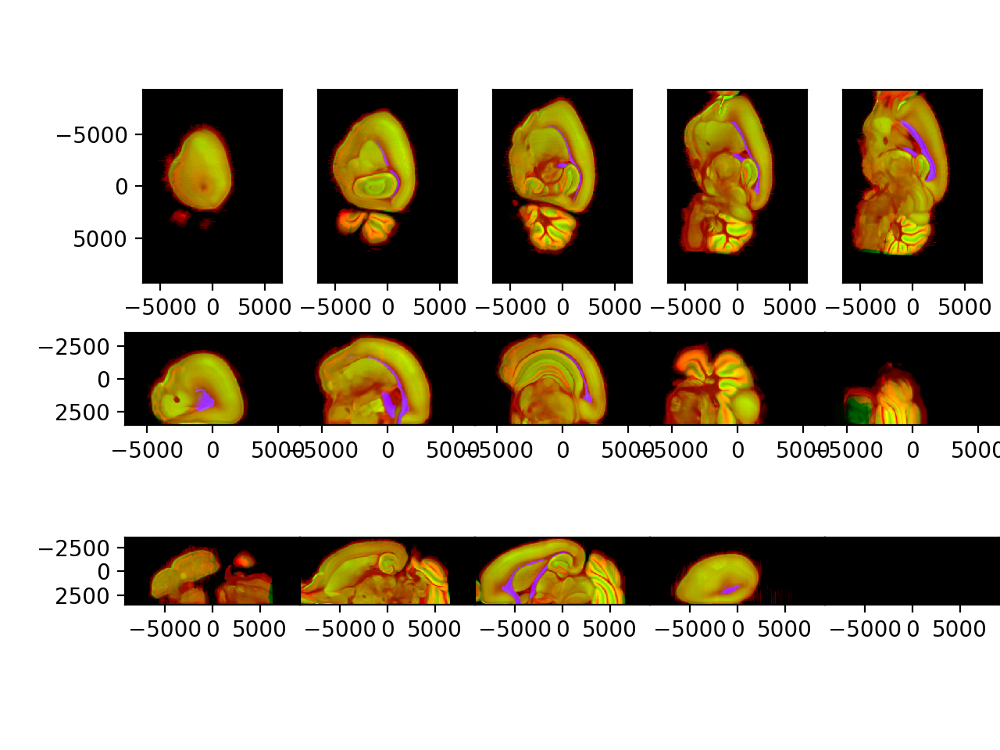

4294967296 4294967296


In [78]:
fig,ax = emlddmm.draw(It,xJ)
fig.subplots_adjust(wspace=0,hspace=0,right=1)
fig.savefig('Isave.jpg')

<IPython.core.display.Javascript object>


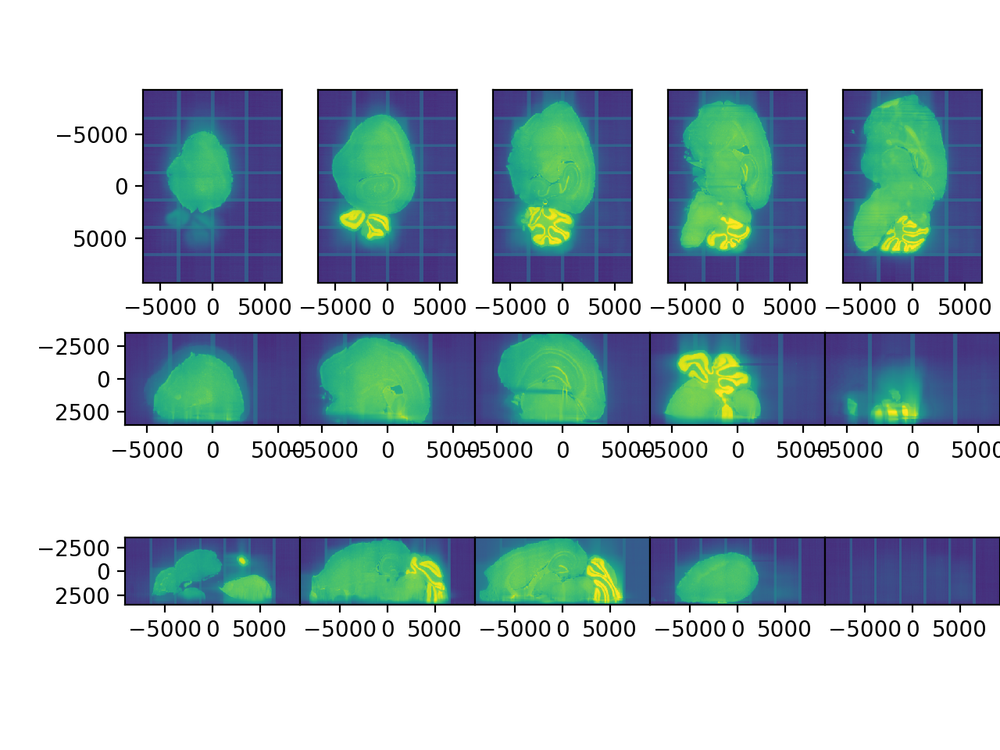

4294967296 4294967296


In [79]:
fig,ax = emlddmm.draw(J,xJ)
plt.subplots_adjust(wspace=0,hspace=0,right=1)
fig.savefig('Jsave.jpg')

In [80]:
dI = [x[1] - x[0] for x in xI]
dJ = [x[1] - x[0] for x in xJ]
dI,dJ

([50.0, 50.0, 50.0], [50.0, 48.600000000000364, 48.599999999999454])

In [81]:
# transform the labels
imp.reload(emlddmm)
deformation = emlddmm.Transform(out2['v'],domain=out2['xv'],direction='f')
affine = emlddmm.Transform(out2['A'],direction='f')
tformi = emlddmm.compose_sequence([deformation,affine,],XI)
#J_ = J0**0.25
J_ = np.copy(J)
Jt = emlddmm.apply_transform_float(xJ,J_,tformi,padding_mode='zeros').cpu().numpy()

<IPython.core.display.Javascript object>


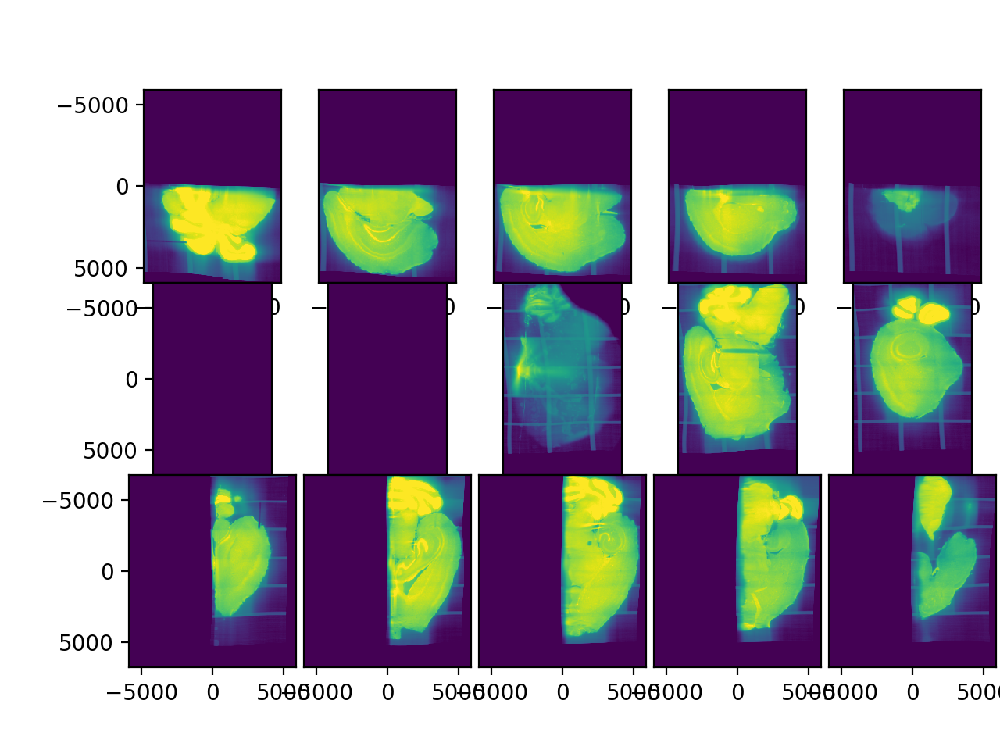

In [82]:
fig,ax = emlddmm.draw(Jt,xI,vmin=np.quantile(J_,0.02),vmax=np.quantile(J_,0.98))
fig.subplots_adjust(wspace=0,hspace=0,right=1)

/home/dtward/.local/intelpython3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


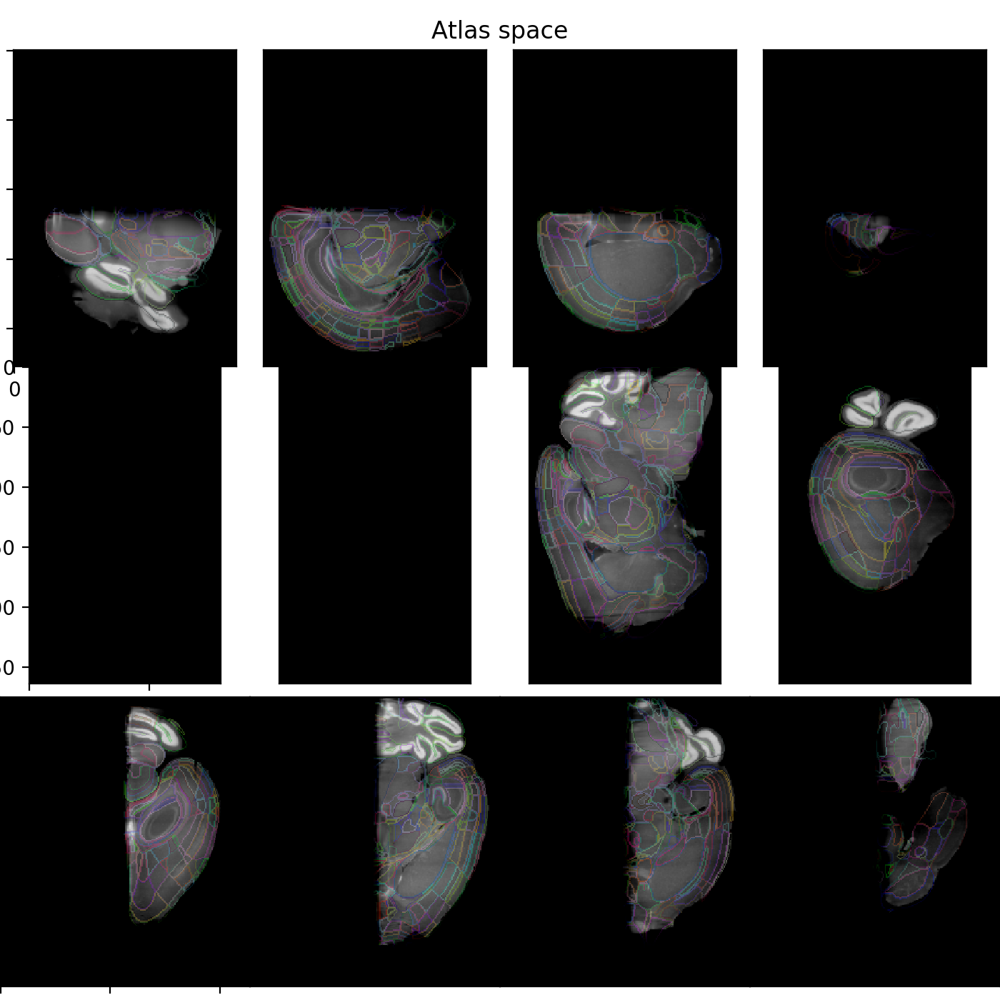

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

4294967296 4294967296


In [83]:
minval = 1.5
maxval = 2.9
alpha = 0.3
fig = plt.figure(figsize=(7,7))
n = 4
slices = np.round(np.linspace(0,I.shape[1],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1)    
    
    # get slices
    RGB_ = RGB[:,slices[i]].transpose(1,2,0)
    S_ = S[0,slices[i]]
    Jt_ = np.copy(Jt[0,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])
    
slices = np.round(np.linspace(0,I.shape[2],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1 + n)    
    
    # get slices
    RGB_ = RGB[:,:,slices[i]].transpose(1,2,0)
    S_ = S[0,:,slices[i]]
    Jt_ = np.copy(Jt[0,:,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])

slices = np.round(np.linspace(0,I.shape[3],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1 + n+n)    
    
    # get slices
    RGB_ = RGB[:,:,:,slices[i]].transpose(1,2,0)
    S_ = S[0,:,:,slices[i]]
    Jt_ = np.copy(Jt[0,:,:,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])    
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])
fig.suptitle('Atlas space')
fig.subplots_adjust(wspace=0,hspace=0,left=0.0,right=1,bottom=0,top=0.95)
fig.savefig(output_prefix+'atlas_space.jpg',**figopts)

/home/dtward/.local/intelpython3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


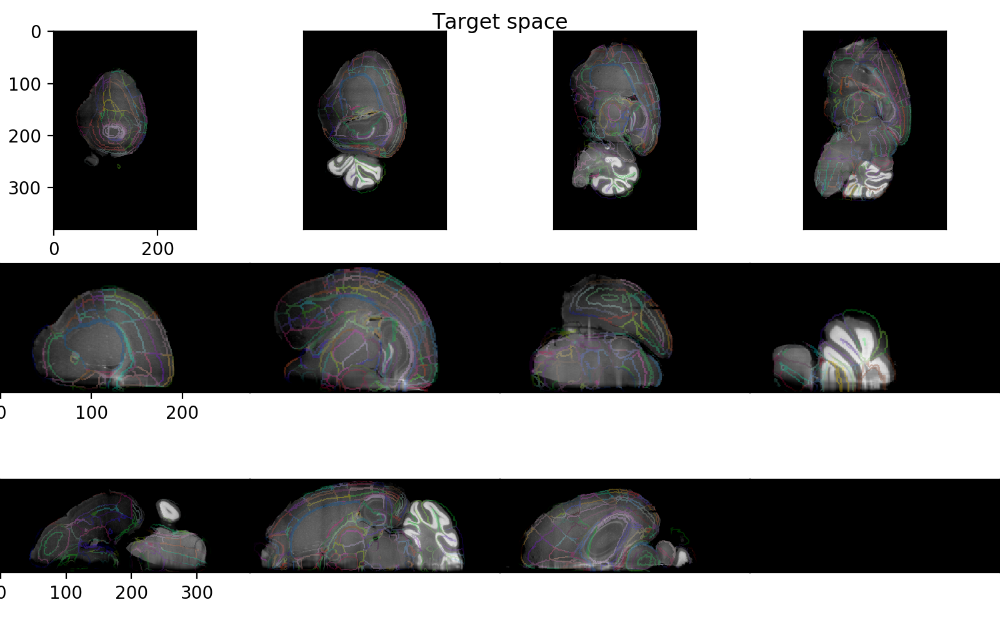

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

4294967296 4294967296


In [84]:

fig = plt.figure(figsize=(8,5))
n = 4
slices = np.round(np.linspace(0,J.shape[1],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1)    
    
    # get slices
    RGB_ = RGBt[:,slices[i]].transpose(1,2,0)
    S_ = St[0,slices[i]]
    Jt_ = np.copy(J[0,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])
    
slices = np.round(np.linspace(0,J.shape[2],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1 + n)    
    
    # get slices
    RGB_ = RGBt[:,:,slices[i]].transpose(1,2,0)
    S_ = St[0,:,slices[i]]
    Jt_ = np.copy(J[0,:,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])

slices = np.round(np.linspace(0,J.shape[3],n+2)[1:-1]).astype(int)
for i in range(n):
    ax = fig.add_subplot(3,n,i+1 + n+n)    
    
    # get slices
    RGB_ = RGBt[:,:,:,slices[i]].transpose(1,2,0)
    S_ = St[0,:,:,slices[i]]
    Jt_ = np.copy(J[0,:,:,slices[i]])
    #Jt_ -= np.quantile(Jt_,0.01)
    Jt_ -= minval
    #Jt_ /= np.quantile(Jt_,0.99)
    Jt_ /= maxval-minval
    # find boundaries
    border = S_ != np.roll(S_,shift=1,axis=0)
    border |= S_ != np.roll(S_,shift=-1,axis=0)
    border |= S_ != np.roll(S_,shift=1,axis=1)
    border |= S_ != np.roll(S_,shift=-1,axis=1)
    
    # draw
    ax.imshow(alpha*border[...,None]*RGB_ + ((1-alpha*border)*Jt_)[...,None])    
    if i>0:
        ax.set_xticks([])
        ax.set_yticks([])
fig.suptitle('Target space')
fig.subplots_adjust(wspace=0,hspace=0,left=0.0,right=1,bottom=0,top=0.95)
fig.savefig(output_prefix+'target_space.jpg',**figopts)

In [85]:
# to do, get the outputs and pickle them

In [ ]:
1

In [ ]:
1